# $$Deteksi\ Fake\ Follower\ Instagram\ dengan\ Metode\ CatBoost$$

## $$Contents$$
* [1. Data Preparation](#$$1.\-Data\-Preparation$$)
    * [1.1 Catboost Installation](#1.1-Catboost-Installation)
    * [1.2 Data Loading](#1.2-Data-Loading)
    * [1.3 Feature Preparation](#1.3-Feature-Preparation)
    * [1.4 Data Splitting](#1.4-Data-Splitting)
* [2. CatBoost Basics](#$$2.\-CatBoost\-Basics$$)
    * [2.1 Model Training](#2.1-Model-Training)
    * [2.2 Model Cross-Validation](#2.2-Model-Cross-Validation)
    * [2.3 Model Applying](#2.3-Model-Applying)
* [3. CatBoost Features](#$$3.\-CatBoost\-Features$$)
    * [3.1 Using the best model](#3.1-Using-the-best-model)
    * [3.2 Early Stopping](#3.2-Early-Stopping)
    * [3.3 Using Baseline](#3.3-Using-Baseline)
    * [3.4 Snapshot Support](#3.4-Snapshot-Support)
    * [3.5 User Defined Objective Function](#3.5-User-Defined-Objective-Function)
    * [3.6 User Defined Metric Function](#3.6-User-Defined-Metric-Function)
    * [3.7 Staged Predict](#3.7-Staged-Predict)
    * [3.8 Feature Importances](#3.8-Feature-Importances)
    * [3.9 Eval Metrics](#3.9-Eval-Metrics)
    * [3.10 Learning Processes Comparison](#3.10-Learning-Processes-Comparison)
    * [3.11 Overfitting Detector](#3.11-Overfitting-Detector)
    * [3.12 Select Decision Boundary](#3.12-Select-Decision-Boundary)
    * [3.13 Shap Values](#3.13-Shap-Values)
    * [3.14 Feature Evaluation](#3.14-Feature-Evaluation)
    * [3.15 Stdout of The Training](#3.15-Stdout-of-The-Training)
    * [3.16 Tree Visualization](#3.16-Tree-Visualization)
    * [3.17 Model Saving](#3.17-Model-Saving)
* [4. Parameters Tuning](#$$4.\-Parameters\-Tuning$$)

## $$1.\ Data\ Preparation$$
### 1.1 CatBoost installation
Jika belum menginstal CatBoost, kita dapat melakukannya dengan menjalankan perintah '!Pip install catboost'.  
 
Kita juga harus menginstal package ipywidgets dan menjalankan perintah khusus sebelum launching jupyter notebook untuk menggambar plot.

In [1]:
!pip install catboost
!pip install ipywidgets
!jupyter nbextension enable --py widgetsnbextension

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: ok


### 1.2 Data Loading
Dataset yang digunakan dalam penelitian ini adalah dataset yang telah tersedia di https://github.com/fcakyon/instafake-dataset. Dataset tersebut terdiri atas dua buah set yang masing-masing berupa file json, yaitu fake account dan automated account.

Dataset fake account dikumpulkan dari akun instagram dari berbagai negara yang kemudian dilabeli secara manual sehingga terkumpul sebanyak 994 akun real dan 200 akun palsu. Informasi yang tersedia dalam dataset tersebut adalah jumlah follower, jumlah following, jumlah posting-an, akun memiliki foto profil atau tidak, bersifat private atau tidak, jumlah karakter pada biografi akun, jumlah karakter pada username, dan jumlah digit pada username. Dataset ini nantinya akan digunakan dalam mendeteksi fake follower.

In [1]:
# Import module yang dibutuhkan

import os
import re
import json
import pandas as pd
import matplotlib.pyplot as plt, seaborn as sns, numpy as np
import catboost
import warnings; warnings.simplefilter('ignore')
import sklearn
from sklearn import metrics
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.datasets import make_classification, make_regression
from catboost import CatBoostClassifier, CatBoostRegressor, Pool, cv
from catboost.eval.catboost_evaluation import *
from catboost import *
from catboost import datasets
from catboost.utils import create_cd
from plotly.offline import iplot, init_notebook_mode  # Import plotly untuk menampilkan plot
%matplotlib inline
plt.style.use('bmh'); sns.set()

print('Imported Module')

Imported Module


In [2]:
# Membuat dataframe FakeReal Account

# Buka file json 

with open("FakeReal.json", "r") as file:
    data = json.load(file)
        
dataframe = pd.DataFrame()

for i in data:
    user_follower_count = i["userFollowerCount"]
    user_following_count = i["userFollowingCount"]
    follower_following_ratio = user_follower_count/max(1,user_following_count)
            
    temp_dataframe = pd.Series({"user_media_count":i["userMediaCount"],
                                "user_follower_count":i["userFollowerCount"],
                                "user_following_count":i["userFollowingCount"],
                                "user_has_profil_pic":i["userHasProfilPic"],
                                "user_is_private":i["userIsPrivate"],
                                "follower_following_ratio":follower_following_ratio,
                                "user_biography_length":i["userBiographyLength"],
                                "username_length":i["usernameLength"],
                                "username_digit_count":i["usernameDigitCount"],
                                "is_fake":i["isFake"]
                                })
    
    dataframe = dataframe.append(temp_dataframe, ignore_index=True)

dataframe[['user_has_profil_pic', 'user_is_private', 'is_fake']] = dataframe[['user_has_profil_pic','user_is_private','is_fake']].astype('int32')
dataframe=dataframe[['is_fake','follower_following_ratio','user_biography_length','user_follower_count','user_following_count','user_has_profil_pic','user_is_private','user_media_count','username_digit_count','username_length']]

cols = list(dataframe.columns.values)
print("jumlah data :", len(dataframe))

jumlah data : 1194


In [6]:
# Menampilkan lima data pertama
dataframe.head()

,is_fake,follower_following_ratio,user_biography_length,user_follower_count,user_following_count,user_has_profil_pic,user_is_private,user_media_count,username_digit_count,username_length
0,1,0.012907,0.0,25.0,1937.0,1,1,0.0,0.0,10.0
1,1,0.078603,0.0,324.0,4122.0,1,0,0.0,4.0,15.0
2,1,0.037594,0.0,15.0,399.0,0,0,0.0,3.0,12.0
3,1,0.130841,0.0,14.0,107.0,1,0,1.0,1.0,10.0
4,1,0.056762,0.0,264.0,4651.0,1,0,0.0,0.0,14.0


In [5]:
# Ukuran Data
N, P = dataframe.shape
print('baris = ', N, ', Kolom = ', P)

dataframe.info()

baris =  1194 , Kolom =  10
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1194 entries, 0 to 1193
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   is_fake                   1194 non-null   int32  
 1   follower_following_ratio  1194 non-null   float64
 2   user_biography_length     1194 non-null   float64
 3   user_follower_count       1194 non-null   float64
 4   user_following_count      1194 non-null   float64
 5   user_has_profil_pic       1194 non-null   int32  
 6   user_is_private           1194 non-null   int32  
 7   user_media_count          1194 non-null   float64
 8   username_digit_count      1194 non-null   float64
 9   username_length           1194 non-null   float64
dtypes: float64(7), int32(3)
memory usage: 79.4 KB


In [6]:
dataframe.columns

Index(['is_fake', 'follower_following_ratio', 'user_biography_length',
       'user_follower_count', 'user_following_count', 'user_has_profil_pic',
       'user_is_private', 'user_media_count', 'username_digit_count',
       'username_length'],
      dtype='object')

Dari info diatas dapat diketahui bahwa dataset memuat 10 variabel, yaitu
1. follower_following_ratio : Perbandingan jumlah follower dengan jumlah following dari setiap akun
2. is_fake : Apakah akun merupakan akun palsu (Bernilai Benar = 1) atau akun asli (Bernilai salah = 0)
3. user_biography_length : Jumlah karakter dalam biografi akun
4. user_follower_count : Jumlah follower dalam setiap akun
5. user_following_count : Jumlah following dalam setiap akun
6. user_has_profil_pic : Apakah akun memiliki foto profil atau tidak
7. user_is_private : Apakah akun bersifat private atau tidak
8. user_media_count : Jumlah postingan yang terdapat dalam setiap akun
9. username_digit_count : Jumlah digit pada username
10. username_length : Jumlah karakter pada username

### 1.3 Feature Preparation

Pertama kita periksa berapa banyak missing value yang terdapat dalam data:

In [16]:
# Mengecek Missing Values
print(dataframe.isnull().sum())

is_fake                     0
follower_following_ratio    0
user_biography_length       0
user_follower_count         0
user_following_count        0
user_has_profil_pic         0
user_is_private             0
user_media_count            0
username_digit_count        0
username_length             0
dtype: int64


Dari output diatas terlihat bahwa tidak terdapat missing value pada setiap variabelnya.

In [30]:
# Melihat tipe data

print(x.dtypes)

follower_following_ratio    float64
user_biography_length       float64
user_follower_count         float64
user_following_count        float64
user_has_profil_pic           int32
user_is_private               int32
user_media_count            float64
username_digit_count        float64
username_length             float64
dtype: object


Perhatikan bahwa fitur memiliki tipe berbeda. Beberapa di antaranya numerik dan beberapa kategorik. Namun dalam dataset ini fitur kategorik telah diubah menjadi fitur numerik yaitu user_has_profil_pic dan user_is_private. 

Dengan menggunakan Catboost mengolah data menjadi lebih mudah karena fitur dalam bentuk string yang biasanya harus ditangani dengan cara tertentu dapat langsung diperlakukan sebagai fitur kategorik. 

In [3]:
# Deklarasi fitur kategorik

cat_features = ['user_has_profil_pic', 'user_is_private']
cat_features

['user_has_profil_pic', 'user_is_private']

In [33]:
# Melihat berapa banyak nilai unik yang dimiliki setiap variabel kategori:

x[cat_features].nunique()

user_has_profil_pic    2
user_is_private        2
dtype: int64

In [4]:
# Membagi menjadi data train dan test

from sklearn.model_selection import train_test_split

train, test = train_test_split(dataframe, test_size = 0.2, random_state=42) # 80% train dan 20% test

In [ ]:
# Menyimpan data dalam bentuk file csv

dataset_dir = 'C:/Users/dell latitude/Documents/SKRIPSI/IG/FakeReal'
if not os.path.exists(dataset_dir):
    os.makedirs(dataset_dir)

train.to_csv(
    os.path.join(dataset_dir, 'data_train.csv'),
    index=False, sep=',', header=True
)
test.to_csv(
    os.path.join(dataset_dir, 'data_test.csv'),
    index=False, sep=',', header=True
)

In [35]:
# Melihat beberapa data dari file csv yang telah kita simpan

with open('C:/Users/dell latitude/Documents/SKRIPSI/IG/FakeReal/data_train.csv') as f:
    for _ in range(10): # 10 baris pertama
        print(f.readline())

is_fake,follower_following_ratio,user_biography_length,user_follower_count,user_following_count,user_has_profil_pic,user_is_private,user_media_count,username_digit_count,username_length

0,1.0063291139240507,16.0,636.0,632.0,1,0,111.0,0.0,5.0

1,0.039473684210526314,0.0,3.0,76.0,1,1,0.0,2.0,12.0

0,0.812,53.0,203.0,250.0,1,1,131.0,0.0,8.0

0,0.9803921568627451,0.0,200.0,204.0,1,1,60.0,2.0,16.0

0,1.0782608695652174,0.0,124.0,115.0,1,0,143.0,0.0,6.0

1,0.07021791767554479,0.0,58.0,826.0,1,0,0.0,4.0,12.0

1,0.7073170731707317,0.0,29.0,41.0,0,1,0.0,0.0,9.0

0,1.5516074450084603,37.0,917.0,591.0,1,1,48.0,0.0,8.0

0,0.2807017543859649,26.0,16.0,57.0,1,1,4.0,2.0,14.0



In [5]:
# Memisahkan fitur(x) dan label(y) 

x = train.drop('is_fake', axis = 1)
y = train.is_fake

x_test = test.drop('is_fake', axis = 1)
y_test = test.is_fake

In [14]:
# Membuat fitur yang mendeskripsikan file (untuk membuat Pool dari dataset)

feature_names = dict()
for column, name in enumerate(train):
    if column == 0:
        continue
    feature_names[column - 1] = name
    
create_cd(
    label=0, 
    cat_features= list(range(5, train.columns.shape[0]-3)),
    feature_names=feature_names,
    output_path=os.path.join(dataset_dir, 'train.cd')
)

In [8]:
# Membuat Pool Class
# Kelas ini digunakan sebagai dataset di CatBoost. Sama halnya seperti menggunakan numpy array atau dataframe.
# Akan tetapi menggunakan Pool Class adalah cara paling efisien dalam hal memori dan kecepatan.  
# Hal ini efektif (dalam hal waktu) untuk memuat data dari file, dibandingkan dengan menggunakan pandas Dataframe.

# Cara 1:
pool1 = Pool(data=x, label=y, cat_features=cat_features) #, has_header=True)

# Cara 2:
pool2 = Pool(
    data=os.path.join(dataset_dir, 'data_train.csv'), 
    delimiter=',', 
    column_description=os.path.join(dataset_dir, 'train.cd'),
    has_header=True
) 

# Cara 3:
pool3 = Pool(data=x, cat_features=cat_features)

# Cara 4
# Cara tercepat untuk membuat Pool Class adalah dengan membuatnya dari matriks numpy.
# Cara ini harus digunakan jika kita ingin prediksi cepat
# atau menginginkan cara tercepat untuk memuat data dengan python.

x_prepared = x.values.astype(str).astype(object)

# Untuk fitur-fitur kategorik, kelas data harus memiliki tipe str

pool4 = Pool(
    data=FeaturesData(
        cat_feature_data=x_prepared,
        cat_feature_names=list(x)
    ),
    label=y.values
)

print('Ukuran Dataset\n')
print('Dataset 1:' + str(pool1.shape) +
      '\nDataset 2:' + str(pool2.shape) + 
      '\nDataset 3:' + str(pool3.shape) +
      '\nDataset 4:' + str(pool4.shape))

print('\n')
print('Nama Kolom\n')
print('Dataset 1:')
print(pool1.get_feature_names()) 
print('\nDataset 2:')
print(pool2.get_feature_names())
print('\nDataset 3:')
print(pool3.get_feature_names())
print('\nDataset 4:')
print(pool4.get_feature_names())

Ukuran Dataset

Dataset 1:(955, 9)
Dataset 2:(955, 9)
Dataset 3:(955, 9)
Dataset 4:(955, 9)


Nama Kolom

Dataset 1:
['follower_following_ratio', 'user_biography_length', 'user_follower_count', 'user_following_count', 'user_has_profil_pic', 'user_is_private', 'user_media_count', 'username_digit_count', 'username_length']

Dataset 2:
['follower_following_ratio', 'user_biography_length', 'user_follower_count', 'user_following_count', 'user_has_profil_pic', 'user_is_private', 'user_media_count', 'username_digit_count', 'username_length']

Dataset 3:
['follower_following_ratio', 'user_biography_length', 'user_follower_count', 'user_following_count', 'user_has_profil_pic', 'user_is_private', 'user_media_count', 'username_digit_count', 'username_length']

Dataset 4:
['follower_following_ratio', 'user_biography_length', 'user_follower_count', 'user_following_count', 'user_has_profil_pic', 'user_is_private', 'user_media_count', 'username_digit_count', 'username_length']


#### Visualisasi Data

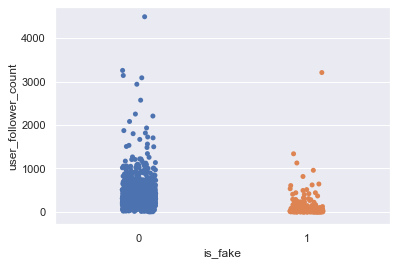

In [6]:
# Plot jumlah follower

p = sns.stripplot(x=dataframe['is_fake'], y=dataframe['user_follower_count'])

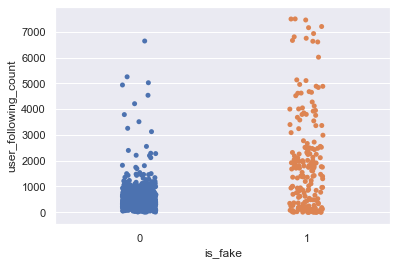

In [7]:
# Plot jumlah following

p = sns.stripplot(x=dataframe['is_fake'], y=dataframe['user_following_count'])

In [8]:
# Melihat akun palsu berdasarkan kepemilikan foto profil

dataframe[['user_has_profil_pic', 'is_fake']].groupby(['user_has_profil_pic'], as_index=False).mean().sort_values(by='is_fake', ascending=False)

,user_has_profil_pic,is_fake
0,0,0.858696
1,1,0.109800


#### Menampilkan Imbalanced Class

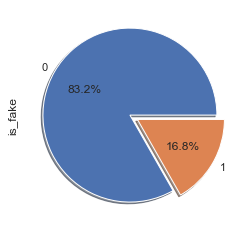

In [5]:
# Melihat jumlah fake account dan real account
# PieChart
is_fake : {0, 1}
plot = dataframe.is_fake.value_counts().plot.pie(explode = [0, 0.1], autopct = '%1.1f%%', shadow = True)

Fake Account 200
Real Account 994


Text(0.5, 1, 'Class Counts')

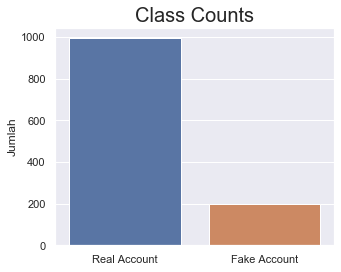

In [7]:
# Menampilkan jumlah masing-masing kelas

fake = dataframe[dataframe["is_fake"] == 1].shape[0]
real = dataframe[dataframe["is_fake"] == 0].shape[0]
print("Fake Account",fake)
print("Real Account",real)
plt.figure(figsize=(5, 4))
sns.countplot(dataframe["is_fake"])
plt.xticks((0, 1), ["Real Account", "Fake Account"])
plt.xlabel("")
plt.ylabel("Jumlah")
plt.title("Class Counts", y=1, fontdict={"fontsize": 20})

Kelas tidak seimbang. Terdapat 994 akun nyata dan 200 akun palsu.

In [16]:
print('Total Data Train: {}'.format(train.shape[0]), 'dengan Jumlah Real Account {}'.format(sum(y==0)), 'dan Jumlah Fake Account {}'.format(sum(y==1)))
print('Total Data Test: {}'.format(x_test.shape[0]), 'dengan Jumlah Real Account {}'.format(sum(y_test==0)), 'dan Jumlah Fake Account {}'.format(sum(y_test==1)))

Total Data Train: 955 dengan Jumlah Real Account 794 dan Jumlah Fake Account 161
Total Data Test: 239 dengan Jumlah Real Account 200 dan Jumlah Fake Account 39


#### Oversampling dengan SMOTE-NC

In [24]:
from imblearn.over_sampling import SMOTENC

ovr = SMOTENC(random_state=0, categorical_features=[0,5,6])
x_over, y_over = ovr.fit_resample(x, y.ravel())

In [25]:
x_table_smotenc = pd.DataFrame(x_over)
y_table_smotenc = pd.DataFrame(y_over)
balanced = pd.concat([y_table_smotenc, x_table_smotenc], axis=1)
balanced = pd.DataFrame(balanced)

balanced.columns = [
    'is_fake',
    'follower_following_ratio',
    'user_biography_length',
    'user_follower_count',
    'user_following_count',
    'user_has_profil_pic',
    'user_is_private',
    'user_media_count',
    'username_digit_count',
    'username_length'
]

Fake Account 794
Real Account 794


Text(0.5, 1, 'Class Counts')

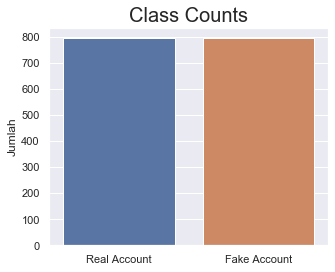

In [28]:
# Menampilkan jumlah masing-masing kelas

fake = balanced[balanced["is_fake"] == 1].shape[0]
real = balanced[balanced["is_fake"] == 0].shape[0]
print("Fake Account", fake)
print("Real Account", real)
plt.figure(figsize=(5, 4))
sns.countplot(balanced["is_fake"])
plt.xticks((0, 1), ["Real Account", "Fake Account"])
plt.xlabel("")
plt.ylabel("Jumlah")
plt.title("Class Counts", y=1, fontdict={"fontsize": 20})

In [29]:
print('Total Data Train: {}'.format(x_over.shape[0]), 'dengan Jumlah Real Account {}'.format(sum(y_over==0)), 'dan Jumlah Fake Account {}'.format(sum(y_over==1)))
print('Total Data Test: {}'.format(x_test.shape[0]), 'dengan Jumlah Real Account {}'.format(sum(y_test==0)), 'dan Jumlah Fake Account {}'.format(sum(y_test==1)))

Total Data Train: 1588 dengan Jumlah Real Account 794 dan Jumlah Fake Account 794
Total Data Test: 239 dengan Jumlah Real Account 200 dan Jumlah Fake Account 39


### 1.4 Data Splitting
Membagi data menjadi data train dan data validation

In [6]:
# Jika akan melatih sebuah model, maka kita harus mendeteksi overfitting dan memilih parameter terbaik. 
# Untuk melakukan itu kita perlu memiliki dataset validasi.

from sklearn.model_selection import train_test_split

x_train, x_validation, y_train, y_validation = train_test_split(x, y, train_size=0.8, random_state=42)

# Pool menyimpan semua informasi tentang dataset (fitur, label, indeks fitur kategorik, bobot, dan masih banyak lagi).

train_pool = Pool(data=x_train, label=y_train, cat_features=cat_features)
test_pool = Pool(data=x_test, label=y_test, cat_features=cat_features)
validation_pool = Pool(data=x_validation, label=y_validation, cat_features=cat_features)

print("{:<20} {}".format("Train size:", x_train.shape[0]))
print("{:<20} {}".format("Validation size:", x_validation.shape[0]))
print("{:<20} {}".format("Test size:", x_test.shape[0]))

Train size:          764
Validation size:     191
Test size:           239


## $$2.\ CatBoost\ Basics$$

### 2.1 Model Training
Sekarang kita buat modelnya sendiri. Disini kita akan mencoba menggunakan parameter default karena catboost telah menyediakan baseline yang baik. Hal yang akan kita tentukan di sini adalah parameter `custom_loss` yang digunakan untuk melihat akurasi dan juga dapat digunakan untuk melihat logloss. Fungsi loss yang kita pilih disini adalah `Logloss`

Logloss biasanya digunakan jika hanya ada dua kemungkinan hasil yang bisa berupa 0 atau 1. Sedangkan cross entropy biasanya digunakan jika ada tiga atau lebih kemungkinan hasil.
Log loss dan cross-entropy sedikit berbeda bergantung pada konteksnya, tetapi dalam machine learning saat menghitung tingkat error antara 0 dan 1, keduanya menyelesaikan hal yang sama.

In [8]:
# Melatih Model

model = CatBoostClassifier(
    custom_loss='Accuracy',
    loss_function = 'Logloss',
    #loss_function='CrossEntropy',
    random_seed=42,
    logging_level='Silent'         # Untuk menghilangkan keluaran teks, bisa juga dengan menambahkan verbose=False
)

model.fit(
    x_train, y_train,
    cat_features=cat_features,
    eval_set=(x_validation, y_validation),
    plot=True
)

print('Model is fitted: ' + str(model.is_fitted()))
print('Model params:')
print(model.get_params())
print('Jumlah Pohon: ' + str(model.tree_count_))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Model is fitted: True
Model params:
{'loss_function': 'Logloss', 'random_seed': 42, 'logging_level': 'Silent', 'custom_loss': 'Accuracy'}
Jumlah Pohon: 267


Seperti yang kita lihat bahwa kita dapat melihat pembelajaran model melalui output verbose (teks) atau dengan menggunakan plot (secara pribadi saya memilih menggunakan opsi kedua yaitu cukup dengan memeriksa plot tersebut, dimana salah satu kelebihannya yaitu kita dapat memperbesar area yang kita inginkan)

Dengan ini kita dapat melihat bahwa nilai akurasi terbaik sebesar 0.9843 dicapai pada 5 langkah boosting.

In [38]:
# Coba dengan menggunakan parameter use_best_model

params = {
    'iterations' : 500,
    'custom_loss':'Accuracy',
    'loss_function': 'Logloss',
    'random_seed': 42,
    'logging_level': 'Silent',  
    'use_best_model': True
}

model = CatBoostClassifier(**params)

model.fit(
    train_pool,
    eval_set=validation_pool,
    plot=True
)

print('Model is fitted: ' + str(model.is_fitted()))
print('Model params:')
print(model.get_params())
print('Jumlah Pohon: ' + str(model.tree_count_))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Model is fitted: True
Model params:
{'iterations': 500, 'loss_function': 'Logloss', 'random_seed': 42, 'use_best_model': True, 'logging_level': 'Silent', 'custom_loss': 'Accuracy'}
Jumlah Pohon: 215


Dengan menggunakan parameter use_best_model kita memperoleh nilai akurasi terbaik yang sama dengan model sebelumnya yaitu sebesar 0.9843 yang dicapai pada 4 langkah boosting. Namun perbedaannya yaitu diperoleh nilai logloss yang lebih kecil yaitu 0.06 serta jumlah pohon berkurang menjadi 215 dari model sebelumnya yang berjumlah 267.

### 2.2 Model Cross-Validation

Menggunakan cross validation untuk validasi model, karena lebih baik serta dapat menampilkan plot.

Fungsi cv CatBoost hanya ditujukan untuk validasi silang (cross-validation), tidak dapat digunakan untuk menyetel parameter sehingga tidak digunakan untuk mendapatkan model dengan parameter terbaik.

Satu-satunya parameter yang dapat dipilih berdasarkan cross-validation adalah jumlah iterasi. Pilih iterasi terbaik berdasarkan informasi dari hasil cv dan latih model akhir dengan jumlah iterasi tersebut.

Dalam hal ini dataset dibagi menjadi N folds. Dimana N – 1 folds digunakan untuk pelatihan dan satu fold digunakan untuk estimasi performa model. Pada setiap iterasi, model dievaluasi pada semua N folds secara independen. Skor rata-rata dengan standar deviasi dihitung untuk setiap iterasi.

In [9]:
# Secara default

cv_params = model.get_params()
cv_data = cv(
    train_pool,
    cv_params,
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [10]:
cv_data.head()

,iterations,test-Logloss-mean,test-Logloss-std,train-Logloss-mean,train-Logloss-std,test-Accuracy-mean,test-Accuracy-std,train-Accuracy-mean,train-Accuracy-std
0,0,0.645343,0.005180,0.643679,0.006589,0.934578,0.019285,0.956796,0.015366
1,1,0.588718,0.004227,0.585851,0.003696,0.950285,0.015780,0.960069,0.014232
2,2,0.543394,0.007041,0.539803,0.005678,0.955493,0.013844,0.960728,0.010408
3,3,0.502033,0.008165,0.497100,0.007052,0.954202,0.012575,0.965967,0.006006
4,4,0.471796,0.007606,0.466314,0.009219,0.945056,0.016983,0.963998,0.012640


Sekarang kita memiliki nilai fungsi kerugian di setiap langkah boosting yang dirata-rata sebanyak 3 kali folds, yang seharusnya dapat memberi perkiraan yang lebih akurat tentang kinerja model

In [11]:
print('Best validation accuracy score: {:.2f}±{:.2f} pada step {}'.format(
    np.max(cv_data['test-Accuracy-mean']),
    cv_data['test-Accuracy-std'][np.argmax(cv_data['test-Accuracy-mean'])],
    np.argmax(cv_data['test-Accuracy-mean'])
))

Best validation accuracy score: 0.97±0.02 pada step 221


In [12]:
print('Precise validation accuracy score: {}'.format(np.max(cv_data['test-Accuracy-mean'])))

Precise validation accuracy score: 0.967283874671916


Seperti yang bisa kita lihat bahwa estimasi awal performa pada single validation fold terlalu optimis. Itulah mengapa cross validation sangat penting.

In [13]:
# Melihat nilai rata-rata dan standar deviasi Logloss untuk cross validation pada iterasi terbaik.

best_value = np.min(cv_data['test-Logloss-mean'])  
best_iter = np.argmin(cv_data['test-Logloss-mean'])

print('Best validation Logloss score, not stratified: {:.4f}±{:.4f} pada step {}'.format(
    best_value,
    cv_data['test-Logloss-std'][best_iter],
    best_iter)
)

Best validation Logloss score, not stratified: 0.0951±0.0497 pada step 161


In [14]:
print('Precise validation Logloss score: {}'.format(np.min(cv_data['test-Logloss-mean'])))

Precise validation Logloss score: 0.09513721629933475


In [15]:
# Mengubah beberapa parameter untuk pelatihan di dalam cv

params1 = {}
params1['loss_function'] = 'Logloss'
params1['custom_loss'] = 'Accuracy', 'AUC'       # Secara default : Accuracy
params1['random_seed'] = 63
params1['learning_rate'] = 0.5

cv_data1 = cv(
    params = params1,
    pool = train_pool,
    fold_count=5,                   # Secara default fold_count = 3
    shuffle=True,
    partition_random_seed=0,
    plot=True,
    stratified=False,
    verbose=False
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [42]:
cv_data1.head()

,iterations,test-Logloss-mean,test-Logloss-std,train-Logloss-mean,train-Logloss-std,test-AUC-mean,test-AUC-std
0,0,0.192908,0.014950,0.175666,0.009133,0.978594,0.011166
1,1,0.127494,0.020174,0.096336,0.005149,0.987433,0.004176
2,2,0.113553,0.021156,0.068497,0.006479,0.987704,0.003157
3,3,0.110295,0.031622,0.054336,0.006719,0.989125,0.003888
4,4,0.103483,0.030753,0.046316,0.005762,0.989171,0.003755


In [16]:
print('Best validation accuracy score: {:.2f}±{:.2f} pada step {}'.format(
    np.max(cv_data1['test-Accuracy-mean']),
    cv_data1['test-Accuracy-std'][np.argmax(cv_data1['test-Accuracy-mean'])],
    np.argmax(cv_data1['test-Accuracy-mean'])
))

Best validation accuracy score: 0.97±0.01 pada step 7


In [17]:
print('Precise validation accuracy score: {}'.format(np.max(cv_data1['test-Accuracy-mean'])))

Precise validation accuracy score: 0.9659786721706226


In [64]:
# Melihat nilai rata-rata dan standar deviasi Logloss untuk cross validation pada iterasi terbaik.

best_value = np.min(cv_data1['test-Logloss-mean'])  
best_iter = np.argmin(cv_data1['test-Logloss-mean'])

print('Best validation Logloss score, not stratified: {:.4f}±{:.4f} pada step {}'.format(
    best_value,
    cv_data1['test-Logloss-std'][best_iter],
    best_iter)
)

Best validation Logloss score, not stratified: 0.1022±0.0325 pada step 5


In [65]:
print('Precise validation Logloss score: {}'.format(np.min(cv_data1['test-Logloss-mean'])))

Precise validation Logloss score: 0.1021798616296293


Parameter berikut menjelaskan cara membagi dataset untuk cross validation:

- `stratified` (True / False)
- `folds` (stratified_shuffle_split / shuffle_split / repeated_split / custom iterator)
- `type` (Classical / Inverted / TimeSeries)

Kita lihat bagaimana menggunakan parameter tersebut.

##### Stratified Cross-validation

Stratified cross validation hanya untuk klasifikasi.
Jika `stratified = True`, setiap fold berisi persentase baris yang sama dari setiap kelas sebagai dataset.
Jika `stratified = False`, folds diambil sampelnya secara seragam.

Biasanya, stratified cross validation memiliki nilai standar deviasi kerugian yang lebih kecil.

In [49]:
# stratified cross-validation dengan parameter yang sama
# Untuk kumpulan data yang tidak seimbang (unbalanced dataset), 
# validasi silang berlapis (stratified cross-validation) dapat berguna

params2 = {}
params2['loss_function'] = 'Logloss'
params2['custom_loss'] = 'Accuracy', 'AUC'       
params2['random_seed'] = 63
params2['learning_rate'] = 0.5

cv_data2 = cv(
    params = params2,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    fold_count=5,
    type = 'Classical',
    shuffle=True,
    partition_random_seed=0,
    plot=True,
    stratified=True,
    verbose=False
)

#print_cv_summary(cv_data2)

best_value = np.min(cv_data2['test-Logloss-mean'])
best_iter = np.argmin(cv_data2['test-Logloss-mean'])

print('Best validation Logloss score, stratified: {:.4f}±{:.4f} on step {}'.format(
    best_value,
    cv_data2['test-Logloss-std'][best_iter],
    best_iter)
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Best validation Logloss score, stratified: 0.1028±0.0260 on step 13


In [66]:
print('Best validation accuracy score: {:.2f}±{:.2f} pada step {}'.format(
    np.max(cv_data2['test-Accuracy-mean']),
    cv_data2['test-Accuracy-std'][np.argmax(cv_data2['test-Accuracy-mean'])],
    np.argmax(cv_data2['test-Accuracy-mean'])
))

Best validation accuracy score: 0.96±0.02 pada step 16


In [67]:
print('Precise validation accuracy score: {}'.format(np.max(cv_data2['test-Accuracy-mean'])))

Precise validation accuracy score: 0.9647300068352699


In [68]:
best_value = np.min(cv_data2['test-Logloss-mean'])  
best_iter = np.argmin(cv_data2['test-Logloss-mean'])

print('Best validation Logloss score, not stratified: {:.4f}±{:.4f} pada step {}'.format(
    best_value,
    cv_data2['test-Logloss-std'][best_iter],
    best_iter)
)

Best validation Logloss score, not stratified: 0.1028±0.0260 pada step 13


In [69]:
print('Precise validation Logloss score: {}'.format(np.min(cv_data2['test-Logloss-mean'])))

Precise validation Logloss score: 0.1028469340107396


##### Cross validation dengan sklearn folds

Catboost dapat menggunakan sklearn folds: https://scikit-learn.org/stable/modules/classes.html#module-sklearn.model_selection

Terdapat tiga jenis sklearn folds: ShuffleSplit, RepeatedKFold, dan StratifiedShuffleSplit.

Catatan bahwa parameter `stratified` dan` type` diabaikan dalam kasus ini.

#### 1. Random Permutation Cross validator 

https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.ShuffleSplit.html#sklearn.model_selection.ShuffleSplit

In [18]:
from sklearn.model_selection import ShuffleSplit

shuffle_split = ShuffleSplit(n_splits=5, test_size=.25, random_state=0)
cv_data3 = cv(
    params = params1,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    verbose = False,
    folds = shuffle_split,
    plot=True
)

#print_cv_summary(cv_data3)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

#### 2. Repeated K-Fold cross validator

https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.RepeatedKFold.html#sklearn.model_selection.RepeatedKFold

In [71]:
from sklearn.model_selection import RepeatedKFold

repeated_split = RepeatedKFold(n_splits=5, n_repeats=2, random_state=2652124)
cv_data4 = cv(
    params = params1,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    verbose = False,
    plot=True,
    folds = repeated_split
)

#print_cv_summary(cv_data4)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

#### 3. Stratified ShuffleSplit cross-validator

https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.StratifiedShuffleSplit.html#sklearn.model_selection.StratifiedShuffleSplit

In [72]:
from sklearn.model_selection import StratifiedShuffleSplit

stratified_shuffle_split = StratifiedShuffleSplit(n_splits=5, test_size=0.5, random_state=0)
cv_data5 = cv(
    params = params1,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    verbose = False,
    folds = stratified_shuffle_split,
    plot = True
)

#print_cv_summary(cv_data5)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

##### Jenis CatBoost folds

1. Jika `type = 'Classical'`, maka setiap set pengujian terdiri dari satu fold, dan set pelatihan terkait terdiri dari sisa k-1 folds.

In [73]:
params = {}
params['loss_function'] = 'Logloss'
params['custom_loss'] = 'Accuracy'
params['random_seed'] = 63
params['learning_rate'] = 0.5

In [74]:
cv_data6 = cv(
    params = params,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    fold_count=5,
    shuffle=True,
    plot=True,
    type = 'Classical',
    verbose=False
)

#print_cv_summary(cv_data6)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

2. Jika `type = 'Inverted'`, maka setiap set pengujian terdiri dari k-1 folds, dan set pelatihan terkait terdiri dari folds yang tersisa.

In [75]:
cv_data7 = cv(
    params = params,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    fold_count=5,
    shuffle=True,
    plot=True,
    type = 'Inverted',
    verbose=False
)

#print_cv_summary(cv_data7)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

3. Jika `type = TimeSeries`, maka setiap set pelatihan terdiri dari k folds pertama, dan set pengujian terkait terdiri dari folds ke-(k + 1).

Biasanya, jenis fold ini mengurangi nilai standar deviasi kerugian, jika urutan baris dalam dataset itu penting.

In [76]:
cv_data8 = cv(
    params = params,
    pool = Pool(x_train, label=y_train, cat_features=cat_features),
    fold_count=5,
    shuffle=True,
    plot=True,
    type = 'TimeSeries',
    verbose=False
)

#print_cv_summary(cv_data8)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

##### Berdasarkan hasil parameter tuning

In [20]:
# Mendapatkan semua data cv dengan menggunakan parameter terbaik:

model = CatBoostClassifier(
    l2_leaf_reg=int(4.0),                    # Hasil parameter tuning
    learning_rate=0.46181411601283945,       # Hasil parameter tuning
    iterations=500,
    custom_loss=['Accuracy', 'AUC'],
    random_seed=42,
    verbose=False,
    loss_function='Logloss',
)

cv_params = model.get_params()
cv_data = cv(
    train_pool,
    cv_params,
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [21]:
cv_data.head()

,iterations,test-Logloss-mean,test-Logloss-std,train-Logloss-mean,train-Logloss-std,test-Accuracy-mean,test-Accuracy-std,train-Accuracy-mean,train-Accuracy-std,test-AUC-mean,test-AUC-std
0,0,0.262047,0.019519,0.238031,0.036844,0.930651,0.015737,0.956145,0.016358,0.955455,0.015142
1,1,0.143624,0.017844,0.110880,0.031367,0.955504,0.004443,0.958113,0.017690,0.986008,0.006262
2,2,0.117682,0.033480,0.075724,0.021070,0.956826,0.010267,0.975791,0.011474,0.988726,0.007778
3,3,0.111737,0.040366,0.064730,0.019317,0.952899,0.013516,0.982994,0.009251,0.988552,0.009043
4,4,0.104295,0.044082,0.051803,0.017497,0.963347,0.013840,0.988228,0.010182,0.989796,0.008221


In [27]:
print('Best validation accuracy score: {:.2f}±{:.2f} pada step {}'.format(
    np.max(cv_data['test-Accuracy-mean']),
    cv_data['test-Accuracy-std'][np.argmax(cv_data['test-Accuracy-mean'])],
    np.argmax(cv_data['test-Accuracy-mean'])
))
print('\nPrecise validation accuracy score: {}'.format(np.max(cv_data['test-Accuracy-mean'])))

Best validation accuracy score: 0.97±0.02 pada step 39

Precise validation accuracy score: 0.9725229658792651


In [26]:
# Melihat nilai rata-rata dan standar deviasi Logloss untuk cross validation pada iterasi terbaik.

best_value = np.min(cv_data['test-Logloss-mean'])  
best_iter = np.argmin(cv_data['test-Logloss-mean'])

print('Best validation Logloss score: {:.4f}±{:.4f} pada step {}'.format(
    best_value,
    cv_data['test-Logloss-std'][best_iter],
    best_iter)
)
print('\nPrecise validation Logloss score: {}'.format(np.min(cv_data['test-Logloss-mean'])))

Best validation Logloss score: 0.0926±0.0531 pada step 13

Precise validation Logloss score: 0.0926467680911618


Diperoleh peningkatan pada nilai akurasi dan juga penurunan pada nilai logloss sehingga merupakan hasil terbaik dibandingkan dengan penggunaan parameter lain yang telah dicoba sebelumnya.

### 2.3 Model Applying
Ada banyak cara untuk melakukan prediksi.
Yang termudah adalah memanggil predict atau predict_proba.

In [33]:
predictions = model.predict(x_validation)
predictions_probs = model.predict_proba(x_validation)
print(predictions[:10])
print(predictions_probs[:10])

[0 1 0 0 1 1 0 0 0 0]
[[0.995  0.005 ]
 [0.0274 0.9726]
 [0.994  0.006 ]
 [0.994  0.006 ]
 [0.0921 0.9079]
 [0.1243 0.8757]
 [0.9962 0.0038]
 [0.9915 0.0085]
 [0.9722 0.0278]
 [0.9764 0.0236]]


In [34]:
print(model.predict_proba(data=x_validation))

[[0.995  0.005 ]
 [0.0274 0.9726]
 [0.994  0.006 ]
 [0.994  0.006 ]
 [0.0921 0.9079]
 [0.1243 0.8757]
 [0.9962 0.0038]
 [0.9915 0.0085]
 [0.9722 0.0278]
 [0.9764 0.0236]
 [0.9956 0.0044]
 [0.9938 0.0062]
 [0.9942 0.0058]
 [0.9767 0.0233]
 [0.9955 0.0045]
 [0.9772 0.0228]
 [0.9575 0.0425]
 [0.9955 0.0045]
 [0.9946 0.0054]
 [0.9954 0.0046]
 [0.994  0.006 ]
 [0.9948 0.0052]
 [0.9962 0.0038]
 [0.1132 0.8868]
 [0.9886 0.0114]
 [0.9963 0.0037]
 [0.9867 0.0133]
 [0.9857 0.0143]
 [0.9946 0.0054]
 [0.9926 0.0074]
 [0.994  0.006 ]
 [0.1055 0.8945]
 [0.9959 0.0041]
 [0.9959 0.0041]
 [0.9939 0.0061]
 [0.9908 0.0092]
 [0.9937 0.0063]
 [0.9958 0.0042]
 [0.9854 0.0146]
 [0.9961 0.0039]
 [0.9945 0.0055]
 [0.9499 0.0501]
 [0.9904 0.0096]
 [0.9902 0.0098]
 [0.9942 0.0058]
 [0.9939 0.0061]
 [0.9861 0.0139]
 [0.9829 0.0171]
 [0.995  0.005 ]
 [0.9826 0.0174]
 [0.9268 0.0732]
 [0.9947 0.0053]
 [0.0458 0.9542]
 [0.1231 0.8769]
 [0.5535 0.4465]
 [0.9963 0.0037]
 [0.1368 0.8632]
 [0.0585 0.9415]
 [0.9938 0.006

In [41]:
print(model.predict(data=x_validation))

[0 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 1 1 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 1 0 0 0
 1 1 0 1 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 1 0 0 1 1 0 0 0 0 0 1 0
 0 0 0 0 0 0]


Untuk klasifikasi biner nilai yang dihasilkan tidak dalam nilai [0,1]. Nilainya adalah nilai numerik. Sehingga untuk mendapatkan probabilitas dari nilai ini, kita perlu menghitung sigmoid dari nilai tersebut.

In [35]:
raw_pred = model.predict(
    data=x_validation,
    prediction_type='RawFormulaVal'
)
print(raw_pred)

[-5.2837  3.5696 -5.1131 -5.118   2.2878  1.9522 -5.5623 -4.7612 -3.5528
 -3.7227 -5.4188 -5.0823 -5.1456 -3.7352 -5.3965 -3.7564 -3.1141 -5.3936
 -5.2196 -5.3706 -5.1032 -5.261  -5.5591  2.0582 -4.4656 -5.6009 -4.3048
 -4.2361 -5.2143 -4.8967 -5.1063  2.1371 -5.484  -5.4823 -5.1012 -4.6811
 -5.0681 -5.4576 -4.2131 -5.5436 -5.1999 -2.9433 -4.639  -4.6196 -5.1508
 -5.0902 -4.2642 -4.0537 -5.3025 -4.0318 -2.538  -5.2257  3.0358  1.9636
 -0.2149 -5.5893  1.842   2.779  -5.0797 -3.643  -1.4451 -5.0648 -4.3595
 -5.3461 -5.5542 -4.0278 -4.6893 -5.4111 -5.4714 -4.3333 -5.2732 -4.3316
 -5.1894 -4.2717  1.5694 -5.487  -2.7997  2.3525  2.3062 -5.4652 -3.6056
 -4.2743 -4.9412 -4.9874  0.3783 -4.8186 -3.0066 -2.3397 -4.8571  2.4484
 -4.7255 -4.3234 -4.9072 -4.3631 -5.4455 -4.7807 -3.1105  2.5134 -5.3103
 -5.5869 -5.2545 -5.499  -4.2528 -5.0138  2.5936 -2.9666 -5.4297  1.7274
 -5.3939 -5.003  -0.5924  3.2932  1.876  -4.4751  3.1143 -4.8796 -5.5488
 -1.6375 -2.313  -4.7468 -4.8481 -5.4718 -5.2566 -4

In [36]:
from numpy import exp

sigmoid = lambda x: 1 / (1 + exp(-x))

probabilities = sigmoid(raw_pred)

print(probabilities)

[0.005  0.9726 0.006  0.006  0.9079 0.8757 0.0038 0.0085 0.0278 0.0236
 0.0044 0.0062 0.0058 0.0233 0.0045 0.0228 0.0425 0.0045 0.0054 0.0046
 0.006  0.0052 0.0038 0.8868 0.0114 0.0037 0.0133 0.0143 0.0054 0.0074
 0.006  0.8945 0.0041 0.0041 0.0061 0.0092 0.0063 0.0042 0.0146 0.0039
 0.0055 0.0501 0.0096 0.0098 0.0058 0.0061 0.0139 0.0171 0.005  0.0174
 0.0732 0.0053 0.9542 0.8769 0.4465 0.0037 0.8632 0.9415 0.0062 0.0255
 0.1908 0.0063 0.0126 0.0047 0.0039 0.0175 0.0091 0.0044 0.0042 0.013
 0.0051 0.013  0.0055 0.0138 0.8277 0.0041 0.0573 0.9131 0.9094 0.0042
 0.0265 0.0137 0.0071 0.0068 0.5935 0.008  0.0471 0.0879 0.0077 0.9204
 0.0088 0.0131 0.0073 0.0126 0.0043 0.0083 0.0427 0.9251 0.0049 0.0037
 0.0052 0.0041 0.014  0.0066 0.9304 0.049  0.0044 0.8491 0.0045 0.0067
 0.3561 0.9642 0.8671 0.0113 0.9575 0.0075 0.0039 0.1628 0.0901 0.0086
 0.0078 0.0042 0.0052 0.0088 0.0043 0.9519 0.0057 0.9334 0.0133 0.0104
 0.0454 0.0161 0.0062 0.0054 0.7612 0.0044 0.0043 0.0044 0.9604 0.0104
 0.0047

## $$3.\ CatBoost\ Features$$

Kita tidak hanya dapat menentukan parameter `custom_loss` tetapi juga dapat menentukan parameter lain seperti `random_seed`. Secara default catboost memilih beberapa nilai acak untuk seed.

In [77]:
model_without_seed = CatBoostClassifier(iterations=10, logging_level='Silent')
model_without_seed.fit(x_train, y_train, cat_features=cat_features)

print('Random seed yang ditugaskan untuk model: {}'.format(model_without_seed.random_seed_))

Random seed yang ditugaskan untuk model: 0


In [43]:
# Menyetel beberapa parameter

params = {
    'iterations': 500,
    'learning_rate': 0.1,
    'eval_metric': 'Accuracy',
    'random_seed': 42,
    'logging_level': 'Silent',
    'use_best_model': False
}

### 3.1 Using the best model
Jika kita memiliki dataset validasi, maka akan lebih baik untuk menggunakan parameter `use_best_model` selama pelatihan. Secara default, parameter ini diaktifkan. Jika diaktifkan, ansambel pohon yang dihasilkan menyusut ke iterasi terbaik.

In [44]:
# model dikecilkan menjadi beberapa pohon ketika mendapatkan nilai metrik evaluasi terbaik pada dataset validasi. 
# Secara default, metrik evaluasi adalah metrik yang dioptimalkan. 
# Tetapi kita dapat menetapkan metrik evaluasi ke beberapa metrik lainnya. 
# Metrik evaluasi yang digunakan di bawah ini adalah Akurasi.

# Model tanpa menggunakan parameter use_best_model
# Jika tidak ingin modelnya menyusut

model_a = CatBoostClassifier(**params)
model_a.fit(train_pool, eval_set=validation_pool, plot=False)


# Model dengan menggunakan parameter use_best_model
best_model_params = params.copy()
best_model_params.update({
    'use_best_model': True
     #use_best_model=False           # Jika tidak ingin modelnya menyusut, maka dapat mengaturnya seperti di samping
})
best_model = CatBoostClassifier(**best_model_params)
best_model.fit(train_pool, eval_set=validation_pool, plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [45]:
print('Jumlah Pohon Simple Model: {}'.format(model_a.tree_count_))
print('Akurasi Simple model: {:.4}'.format(
    accuracy_score(y_validation, model_a.predict(x_validation))
))
print('')

print('Jumlah Pohon Best Model: {}'.format(best_model.tree_count_))
print('Akurasi Best Model: {:.4}'.format(
    accuracy_score(y_validation, best_model.predict(x_validation))
))

Jumlah Pohon Simple Model: 500
Akurasi Simple model: 0.9738

Jumlah Pohon Best Model: 5
Akurasi Best Model: 0.9843


### 3.2 Early Stopping
Jika memiliki dataset validasi, akan selalu lebih mudah dan lebih baik untuk menggunakan penghentian awal (early stopping). Fitur ini mirip dengan fitur best model, namun selain dapat meningkatkan kualitas juga tetap dapat menghemat waktu.

In [46]:
%%time
model_b = CatBoostClassifier(**params)  
model_b.fit(train_pool, eval_set=validation_pool)

Wall time: 1.15 s


In [44]:
%%time

earlystop_params = params.copy()
earlystop_params.update({
    'od_type': 'Iter',
    'od_wait': 40
})
earlystop_model = CatBoostClassifier(**earlystop_params)
earlystop_model.fit(train_pool, eval_set=validation_pool)

Wall time: 153 ms


In [48]:
print('Jumlah Pohon Simple model: {}'.format(model_b.tree_count_))
print('Akurasi Simple model: {:.4}'.format(
    accuracy_score(y_validation, model_b.predict(x_validation))
))
print('')

print('Jumlah Pohon Early-stopped model: {}'.format(earlystop_model.tree_count_))
print('Akurasi Early-stopped model: {:.4}'.format(
    accuracy_score(y_validation, earlystop_model.predict(x_validation))
))

Jumlah Pohon Simple model: 500
Akurasi Simple model: 0.9738

Jumlah Pohon Early-stopped model: 45
Akurasi Early-stopped model: 0.9791


Jadi kita mendapatkan kualitas yang lebih baik dalam waktu yang lebih singkat. Sehingga berdasarkan contoh ini lebih baik untuk menghentikan proses boosting lebih awal (sebelum overfitting dimulai)

### 3.3 Using Baseline
Hasil pra-training (baseline) dapat digunakan untuk pelatihan.

In [54]:
current_params = params.copy()
current_params.update({
    'iterations': 10
})
model_c = CatBoostClassifier(**current_params).fit(x_train, y_train, cat_features)

# Mendapatkan baseline (hanya dengan prediction_type='RawFormulaVal')
baseline = model_c.predict(x_train, prediction_type='RawFormulaVal')
# Fit model baru
model_c.fit(x_train, y_train, cat_features, baseline=baseline)

### 3.4 Snapshot Support
Di Catboost kita dapat menggunakan snapshot untuk memulihkan pelatihan setelah interruption atau untuk memulai pelatihan dengan hasil sebelumnya.

#### Snapshotting

In [30]:
params_with_snapshot = params.copy()
params_with_snapshot.update({
    'iterations': 5,
    'learning_rate': 0.5,
    'logging_level': 'Verbose'
})
model = CatBoostClassifier(**params_with_snapshot).fit(train_pool, eval_set=validation_pool, save_snapshot=True)
params_with_snapshot.update({
    'iterations': 10,
    'learning_rate': 0.1,
})
model = CatBoostClassifier(**params_with_snapshot).fit(train_pool, eval_set=validation_pool, save_snapshot=True)

0:	learn: 0.9541885	test: 0.9528796	best: 0.9528796 (0)	total: 1.86ms	remaining: 7.44ms
1:	learn: 0.9633508	test: 0.9633508	best: 0.9633508 (1)	total: 3.34ms	remaining: 5.01ms
2:	learn: 0.9659686	test: 0.9633508	best: 0.9633508 (1)	total: 4.91ms	remaining: 3.27ms
3:	learn: 0.9659686	test: 0.9685864	best: 0.9685864 (3)	total: 6.5ms	remaining: 1.62ms
4:	learn: 0.9712042	test: 0.9685864	best: 0.9685864 (3)	total: 7.65ms	remaining: 0us

bestTest = 0.9685863874
bestIteration = 3

5:	learn: 0.9712042	test: 0.9685864	best: 0.9685864 (3)	total: 10.2ms	remaining: 10.2ms
6:	learn: 0.9712042	test: 0.9685864	best: 0.9685864 (3)	total: 12ms	remaining: 6.49ms
7:	learn: 0.9725131	test: 0.9685864	best: 0.9685864 (3)	total: 13.7ms	remaining: 4.04ms
8:	learn: 0.9712042	test: 0.9685864	best: 0.9685864 (3)	total: 15.3ms	remaining: 1.91ms
9:	learn: 0.9712042	test: 0.9685864	best: 0.9685864 (3)	total: 16.9ms	remaining: 0us

bestTest = 0.9685863874
bestIteration = 3



In [39]:
# Jika kita berlatih untuk waktu yang lama, misalnya selama beberapa jam, maka kita perlu menyimpan snapshot. 
# Jika tidak, maka ketika laptop atau server akan reboot, kita akan kehilangan semua progress. 
# Untuk itu, kita perlu menentukan parameter snapshot_file. 
# Coba jalankan kode di bawah ini dan hentikan kernel setelah beberapa saat, kemudian coba jalankan sel yang sama lagi. 
# Pelatihan akan dimulai dari iterasi ketika pelatihan diinterupsi. 
# Perhatikan bahwa semua file tambahan ditulis secara default ke direktori catboost_info. 
# Ini dapat diubah menggunakan parameter train_dir. Jadi file snapshot akan ada di sana.

# !rm 'catboost_info/snapshot.bkp'

model = CatBoostClassifier(
    iterations=40,
    save_snapshot=True,
    snapshot_file='snapshot.bkp',
    snapshot_interval=1,
    random_seed=43
)
model.fit(
    x_train, y_train,
    eval_set=(x_validation, y_validation),
    cat_features=cat_features,
    verbose=True
)

Learning rate set to 0.120264
0:	learn: 0.6105008	test: 0.6084394	best: 0.6084394 (0)	total: 2.15ms	remaining: 83.7ms
1:	learn: 0.5463746	test: 0.5423488	best: 0.5423488 (1)	total: 3.85ms	remaining: 73.2ms
2:	learn: 0.4863575	test: 0.4817123	best: 0.4817123 (2)	total: 6.47ms	remaining: 79.9ms
3:	learn: 0.4336671	test: 0.4298800	best: 0.4298800 (3)	total: 7.88ms	remaining: 70.9ms
4:	learn: 0.3937627	test: 0.3914424	best: 0.3914424 (4)	total: 9.39ms	remaining: 65.7ms
5:	learn: 0.3584493	test: 0.3577696	best: 0.3577696 (5)	total: 10.9ms	remaining: 62ms
6:	learn: 0.3266119	test: 0.3244933	best: 0.3244933 (6)	total: 12.4ms	remaining: 58.6ms
7:	learn: 0.2990084	test: 0.2970411	best: 0.2970411 (7)	total: 13.9ms	remaining: 55.6ms
8:	learn: 0.2760728	test: 0.2750617	best: 0.2750617 (8)	total: 15.5ms	remaining: 53.2ms
9:	learn: 0.2568209	test: 0.2556041	best: 0.2556041 (9)	total: 16.9ms	remaining: 50.7ms
10:	learn: 0.2389906	test: 0.2377608	best: 0.2377608 (10)	total: 18.4ms	remaining: 48.6ms
11

### 3.5 User Defined Objective Function
Kita dapat membuat fungsi objektif sendiri. Di bawah ini kita akan membuat sendiri fungsi objektif logloss.

In [52]:
class LoglossObjective(object):
    def calc_ders_range(self, approxes, targets, weights):
        # approxes, targets, weights containers berindeks floats
        # (containers yang dimana hanya memiliki __len__ and __getitem__ defined).
        # parameter weights bisa kosong/tidak ada
        
        # Untuk memahami apa arti parameter ini, asumsikan bahwa 
        # ada subset dari dataset yang saat ini sedang diproses.
        # perkiraan berisi prediksi saat ini untuk subset tersebut.
        # target berisi nilai target yang kita provide dengan dataset.
        
        # Fungsi ini harus mengembalikan daftar pasangan (der1, der2), dimana
        # der1 adalah turunan pertama dari fungsi kerugian(loss function) terkait ke nilai prediksi
        # dan der2 adalah turunan keduanya.
        
        # Dalam kasus ini, logloss didefinisikan dengan rumus berikut:
        # target * log(sigmoid(approx)) + (1 - target) * (1 - sigmoid(approx))
        # dimana sigmoid(x) = 1 / (1 + e^(-x)).
        
        assert len(approxes) == len(targets)
        if weights is not None:
            assert len(weights) == len(approxes)
        
        result = []
        for index in range(len(targets)):
            e = np.exp(approxes[index])
            p = e / (1 + e)
            der1 = (1 - p) if targets[index] > 0.0 else -p
            der2 = -p * (1 - p)

            if weights is not None:
                der1 *= weights[index]
                der2 *= weights[index]

            result.append((der1, der2))
        return result

In [104]:
model = CatBoostClassifier(
    iterations=10,
    random_seed=42, 
    loss_function=LoglossObjective(), 
    eval_metric="Logloss"
)
# Fit model
model.fit(train_pool)

# Hanya prediction_type = 'RawFormulaVal' yang diizinkan dengan custom `loss_function` 
preds_raw = model.predict(x_test, prediction_type='RawFormulaVal')

0:	learn: 0.6717546	total: 12.4ms	remaining: 112ms
1:	learn: 0.6502494	total: 20.1ms	remaining: 80.2ms
2:	learn: 0.6305099	total: 28.2ms	remaining: 65.9ms
3:	learn: 0.6108675	total: 36.6ms	remaining: 54.9ms
4:	learn: 0.5931649	total: 43.6ms	remaining: 43.6ms
5:	learn: 0.5765790	total: 52.3ms	remaining: 34.8ms
6:	learn: 0.5588634	total: 59.9ms	remaining: 25.7ms
7:	learn: 0.5427009	total: 68.5ms	remaining: 17.1ms
8:	learn: 0.5280079	total: 76.2ms	remaining: 8.46ms
9:	learn: 0.5135963	total: 83.7ms	remaining: 0us


### 3.6 User Defined Metric Function
Selain dapat membuat fungsi objektif sendiri, kita juga dapat membuat fungsi metrik sendiri. Di bawah ini kita akan membuat fungsi metrik logloss. 

In [53]:
class LoglossMetric(object):
    def get_final_error(self, error, weight):
        return error / (weight + 1e-38)           # Mengembalikan nilai akhir metrik berdasarkan error dan bobot

    def is_max_optimal(self):
        return False                              # Return apakah nilai maksimal metrik lebih baik

    def evaluate(self, approxes, target, weight):
        # approxes adalah list dari indexed containers
        # (containers hanya memiliki __len__ and __getitem__ defined), satu container per perkiraan dimensi.
        # Setiap container hanya berisi floats.
        # weight adalah container berindeks satu dimensi. Parameter weight bisa tidak ada.
        # target adalah container berindeks satu dimensi.  
        
        assert len(approxes) == 1
        assert len(target) == len(approxes[0])

        approx = approxes[0]

        error_sum = 0.0
        weight_sum = 0.0

        for i in range(len(approx)):
            e = np.exp(approx[i])
            p = e / (1 + e)
            w = 1.0 if weight is None else weight[i]
            weight_sum += w
            error_sum += -w * (target[i] * np.log(p) + (1 - target[i]) * np.log(1 - p))

        return error_sum, weight_sum

Di bawah ini terdapat contoh pelatihan dengan fungsi Logloss bawaan serta fungsi Logloss dan metrik Logloss yang kita buat sendiri. Seperti yang bisa kita lihat bahwa hasilnya sama.

In [50]:
model1 = CatBoostClassifier(iterations=10, loss_function='Logloss', eval_metric='Logloss',
                            learning_rate=0.03, bootstrap_type='Bayesian', boost_from_average=False,
                            leaf_estimation_iterations=1, leaf_estimation_method='Gradient')
model1.fit(x_train, y_train, eval_set=(x_test, y_test))

0:	learn: 0.6867687	test: 0.6868097	best: 0.6868097 (0)	total: 1.67ms	remaining: 15ms
1:	learn: 0.6809487	test: 0.6808664	best: 0.6808664 (1)	total: 3.45ms	remaining: 13.8ms
2:	learn: 0.6749478	test: 0.6746864	best: 0.6746864 (2)	total: 5.18ms	remaining: 12.1ms
3:	learn: 0.6692801	test: 0.6690911	best: 0.6690911 (3)	total: 7.02ms	remaining: 10.5ms
4:	learn: 0.6637909	test: 0.6634174	best: 0.6634174 (4)	total: 8.73ms	remaining: 8.73ms
5:	learn: 0.6581477	test: 0.6576394	best: 0.6576394 (5)	total: 10.5ms	remaining: 6.98ms
6:	learn: 0.6527516	test: 0.6519579	best: 0.6519579 (6)	total: 12.1ms	remaining: 5.21ms
7:	learn: 0.6469987	test: 0.6462177	best: 0.6462177 (7)	total: 13.9ms	remaining: 3.47ms
8:	learn: 0.6413990	test: 0.6405574	best: 0.6405574 (8)	total: 15.7ms	remaining: 1.74ms
9:	learn: 0.6359587	test: 0.6353356	best: 0.6353356 (9)	total: 17.4ms	remaining: 0us

bestTest = 0.6353356048
bestIteration = 9



In [54]:
model2 = CatBoostClassifier(iterations=10, loss_function=LoglossObjective(), eval_metric=LoglossMetric(), 
                            learning_rate=0.03, bootstrap_type='Bayesian', boost_from_average=False,
                            leaf_estimation_iterations=1, leaf_estimation_method='Gradient')
model2.fit(x_train, y_train, eval_set=(x_test, y_test))

0:	learn: 0.6867687	test: 0.6868097	best: 0.6868097 (0)	total: 28.5ms	remaining: 256ms
1:	learn: 0.6809487	test: 0.6808664	best: 0.6808664 (1)	total: 49.4ms	remaining: 198ms
2:	learn: 0.6749478	test: 0.6746864	best: 0.6746864 (2)	total: 75.1ms	remaining: 175ms
3:	learn: 0.6692801	test: 0.6690911	best: 0.6690911 (3)	total: 92.8ms	remaining: 139ms
4:	learn: 0.6637909	test: 0.6634174	best: 0.6634174 (4)	total: 116ms	remaining: 116ms
5:	learn: 0.6581477	test: 0.6576394	best: 0.6576394 (5)	total: 135ms	remaining: 90.2ms
6:	learn: 0.6527516	test: 0.6519579	best: 0.6519579 (6)	total: 156ms	remaining: 66.8ms
7:	learn: 0.6469987	test: 0.6462177	best: 0.6462177 (7)	total: 172ms	remaining: 43ms
8:	learn: 0.6413990	test: 0.6405574	best: 0.6405574 (8)	total: 185ms	remaining: 20.5ms
9:	learn: 0.6359587	test: 0.6353356	best: 0.6353356 (9)	total: 197ms	remaining: 0us

bestTest = 0.6353356048
bestIteration = 9



### 3.7 Staged Predict
CatBoost memiliki metode `staged_predict`(prediksi bertahap). Hal ini memungkinkan kita untuk dapat memprediksi secara berulang untuk rentang pohon tertentu. Yaitu ketika kita ingin memiliki prediksi pada setiap objek di setiap iterasi (atau pada setiap iterasi ke-k). Ini dapat digunakan jika kita ingin menghitung nilai dari beberapa metrik khusus menggunakan prediksi.

In [111]:
model = CatBoostClassifier(iterations=10, random_seed=42, logging_level='Silent').fit(train_pool)
ntree_start, ntree_end, eval_period = 3, 9, 2
predictions_iterator = model.staged_predict(validation_pool, 'Probability', ntree_start, ntree_end, eval_period)
for preds, tree_count in zip(predictions_iterator, range(ntree_start, ntree_end, eval_period)):
    print('First class probabilities using the first {} trees: {}'.format(tree_count, preds[:5, 1]))

First class probabilities using the first 3 trees: [0.2706 0.6533 0.2706 0.2706 0.6349]
First class probabilities using the first 5 trees: [0.1731 0.7876 0.1446 0.1727 0.7662]
First class probabilities using the first 7 trees: [0.1019 0.8718 0.0935 0.1228 0.8022]


In [112]:
predictions_gen = model.staged_predict_proba(
    data=x_validation,
    ntree_start=0, 
    ntree_end=5, 
    eval_period=1
)
try:
    for iteration, predictions in enumerate(predictions_gen):
        print('Iteration ' + str(iteration) + ', predictions:')
        print(predictions)
except Exception:
    pass

Iteration 0, predictions:
[[0.7255 0.2745]
 [0.4089 0.5911]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.4174 0.5826]
 [0.4174 0.5826]
 [0.7255 0.2745]
 [0.6768 0.3232]
 [0.6265 0.3735]
 [0.6265 0.3735]
 [0.7255 0.2745]
 [0.6678 0.3322]
 [0.6678 0.3322]
 [0.6678 0.3322]
 [0.7255 0.2745]
 [0.6117 0.3883]
 [0.6117 0.3883]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.4426 0.5574]
 [0.6768 0.3232]
 [0.7255 0.2745]
 [0.6265 0.3735]
 [0.6117 0.3883]
 [0.7255 0.2745]
 [0.6768 0.3232]
 [0.7255 0.2745]
 [0.4279 0.5721]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.6768 0.3232]
 [0.6678 0.3322]
 [0.7255 0.2745]
 [0.6678 0.3322]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.6117 0.3883]
 [0.7255 0.2745]
 [0.6768 0.3232]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.7255 0.2745]
 [0.6678 0.3322]
 [0.7255 0.2745]
 [0.3353 0.6647]
 [0.3353 0.6647]
 [0.6457 0.3543]
 [0.7255 0.2745]
 [0.3353 0.6647]
 [0.3

### 3.8 Feature Importances
Terkadang sangat penting untuk memahami fitur mana yang memberikan kontribusi terbesar pada hasil akhir. Untuk melakukan hal tersebut, CatBoost memiliki metode `get_feature_importance`. 
Catboost menyediakan beberapa jenis fitur importances.

Sekarang kita akan belajar bagaimana memahami fitur mana yang paling penting. 
Kita latih model yang tidak menggunakan kombinasi fitur terlebih dahulu.
Untuk melarang kombinasi fitur, kita perlu menggunakan 'max_ctr_complexity = 1'. Ini akan mempercepat banyak pelatihan, akan tetapi dapat mengurangi kualitas yang dihasilkan.

In [63]:
# Model tanpa menggunakan kombinasi fitur

model = CatBoostClassifier(
    iterations=200,
    max_ctr_complexity=1,
    random_seed=42,
    learning_rate=0.03,
)
model.fit(train_pool, verbose=50)

0:	learn: 0.6272347	total: 2.89ms	remaining: 576ms
50:	learn: 0.0715588	total: 120ms	remaining: 350ms
100:	learn: 0.0418143	total: 234ms	remaining: 229ms
150:	learn: 0.0297321	total: 359ms	remaining: 117ms
199:	learn: 0.0225211	total: 478ms	remaining: 0us


In [64]:
# Melihat fitur mana yang paling penting untuk model tanpa kombinasi fitur

model.get_feature_importance(prettified=True)

,Feature Id,Importances
0,follower_following_ratio,27.037433
1,user_media_count,21.107084
2,user_following_count,13.390328
3,user_follower_count,10.520245
4,user_has_profil_pic,7.732147
5,username_length,6.346689
6,user_biography_length,6.026791
7,user_is_private,5.062082
8,username_digit_count,2.777200


In [65]:
# Model dengan menggunakan kombinasi fitur

model_k = CatBoostClassifier(iterations=200, random_seed=42, logging_level='Silent').fit(train_pool)

feature_importances = model_k.get_feature_importance(train_pool)
model_k.get_feature_importance(prettified=True)

,Feature Id,Importances
0,follower_following_ratio,27.190319
1,user_media_count,20.711164
2,user_following_count,11.286385
3,user_follower_count,9.945368
4,user_has_profil_pic,8.728279
5,user_biography_length,7.009390
6,username_length,6.758560
7,user_is_private,4.964980
8,username_digit_count,3.405556


Terlihat bahwa fitur **`follower_following_ratio`** dan **`user_media_count`** memiliki pengaruh terbesar terhadap hasil.

### 3.9 Eval Metrics
CatBoost memiliki metode `eval_metrics` untuk dapat menghitung metrik tertentu pada dataset tertentu. Dan tentu saja juga dapat ditampilkan gambarnya.

Kita juga dapat menghitung metrik langsung setelah pelatihan.

In [9]:
model = CatBoostClassifier(
    random_seed=42,
    iterations=200,
    learning_rate=0.03,
)
model.fit(
    x_train, y_train,
    cat_features=cat_features,
    verbose=50
)

0:	learn: 0.6272347	total: 3.54ms	remaining: 706ms
50:	learn: 0.0715588	total: 178ms	remaining: 520ms
100:	learn: 0.0418143	total: 354ms	remaining: 347ms
150:	learn: 0.0297321	total: 517ms	remaining: 168ms
199:	learn: 0.0225211	total: 662ms	remaining: 0us


In [55]:
metrics = model.eval_metrics(
    data=train_pool,
    metrics=['Logloss','AUC'],
    ntree_start=0,
    ntree_end=0,
    eval_period=1,
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [11]:
print('AUC values:')
print(np.array(metrics['AUC']))

AUC values:
[0.9824 0.9867 0.9903 0.9907 0.9922 0.9932 0.9932 0.9933 0.9935 0.994
 0.9941 0.9942 0.994  0.994  0.9942 0.9944 0.9947 0.9946 0.9949 0.9951
 0.995  0.995  0.9952 0.9952 0.9953 0.9954 0.9956 0.9957 0.9958 0.9959
 0.996  0.9962 0.9962 0.9964 0.9965 0.9966 0.9967 0.9967 0.9969 0.9969
 0.997  0.9971 0.9971 0.9971 0.9972 0.9973 0.9973 0.9973 0.9974 0.9974
 0.9974 0.9975 0.9976 0.9976 0.9976 0.9977 0.9977 0.9977 0.9977 0.9978
 0.9978 0.9979 0.9979 0.9979 0.998  0.998  0.998  0.998  0.9981 0.9982
 0.9982 0.9983 0.9983 0.9984 0.9984 0.9984 0.9984 0.9984 0.9984 0.9985
 0.9985 0.9985 0.9985 0.9986 0.9986 0.9987 0.9987 0.9987 0.9987 0.9987
 0.9988 0.9988 0.9988 0.9988 0.9988 0.9989 0.9989 0.9989 0.9989 0.9989
 0.9989 0.9989 0.9989 0.999  0.999  0.9991 0.9991 0.9991 0.9991 0.9991
 0.9991 0.9991 0.9991 0.9992 0.9992 0.9992 0.9992 0.9993 0.9993 0.9993
 0.9993 0.9993 0.9993 0.9993 0.9994 0.9994 0.9994 0.9994 0.9994 0.9994
 0.9994 0.9994 0.9995 0.9995 0.9995 0.9995 0.9995 0.9995 0.9995 0.

In [56]:
model = CatBoostClassifier(iterations=200, random_seed=42, logging_level='Silent').fit(train_pool)
eval_metrics = model.eval_metrics(validation_pool, ['AUC'], plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [17]:
print(eval_metrics['AUC'][:6])

[0.9802360434619708, 0.9861371300112401, 0.9885724990633196, 0.9887598351442488, 0.9900711877107531, 0.9902585237916823]


### 3.10 Learning Processes Comparison
Kita juga dapat membandingkan proses pembelajaran berbagai model pada satu plot.

In [7]:
# Perbandingan Model dengan learning rate yang berbeda

model1 = CatBoostClassifier(
    learning_rate=0.5,
    iterations=100,
    random_seed=0,
    custom_loss=['Accuracy', 'AUC'],
    train_dir='learning_rate_0.5'
)

model2 = CatBoostClassifier(
    learning_rate=0.03,
    iterations=100,
    random_seed=0,
    custom_loss=['Accuracy', 'AUC'],
    train_dir='learning_rate_0.03'
)

model3 = CatBoostClassifier(
    learning_rate=0.1,
    iterations=100,
    random_seed=0,
    custom_loss=['Accuracy', 'AUC'],
    train_dir='learning_rate_0.1'
)

model4 = CatBoostClassifier(
    learning_rate=0.46181411601283945,
    iterations=100,
    random_seed=0,
    custom_loss=['Accuracy', 'AUC'],
    train_dir='learning_rate_0.46181411601283945'
)

model1.fit(
    x_train, y_train,
    eval_set=(x_validation, y_validation),
    cat_features=cat_features,
    verbose=10
)
model2.fit(
    x_train, y_train,
    eval_set=(x_validation, y_validation),
    cat_features=cat_features,
    verbose=10
)
model3.fit(
    x_train, y_train,
    eval_set=(x_validation, y_validation),
    cat_features=cat_features,
    verbose=10
)
model4.fit(
    x_train, y_train,
    eval_set=(x_validation, y_validation),
    cat_features=cat_features,
    verbose=10
)

0:	learn: 0.4024249	test: 0.3944623	best: 0.3944623 (0)	total: 57.5ms	remaining: 5.69s
10:	learn: 0.0699186	test: 0.0801980	best: 0.0801980 (10)	total: 76.3ms	remaining: 618ms
20:	learn: 0.0501809	test: 0.0639116	best: 0.0639116 (20)	total: 92.6ms	remaining: 348ms
30:	learn: 0.0387783	test: 0.0637446	best: 0.0637446 (30)	total: 109ms	remaining: 243ms
40:	learn: 0.0318129	test: 0.0598427	best: 0.0597968 (38)	total: 128ms	remaining: 184ms
50:	learn: 0.0241160	test: 0.0597113	best: 0.0586266 (45)	total: 144ms	remaining: 138ms
60:	learn: 0.0204780	test: 0.0603511	best: 0.0586266 (45)	total: 159ms	remaining: 102ms
70:	learn: 0.0167380	test: 0.0571019	best: 0.0571019 (70)	total: 177ms	remaining: 72.4ms
80:	learn: 0.0146356	test: 0.0549618	best: 0.0549618 (80)	total: 201ms	remaining: 47.1ms
90:	learn: 0.0124521	test: 0.0550228	best: 0.0549618 (80)	total: 216ms	remaining: 21.4ms
99:	learn: 0.0117988	test: 0.0550164	best: 0.0548784 (96)	total: 232ms	remaining: 0us

bestTest = 0.05487839228
best

In [8]:
MetricVisualizer(['learning_rate_0.5', 'learning_rate_0.03', 'learning_rate_0.1', 'learning_rate_0.46181411601283945']).start() 

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

### 3.11 Overfitting Detector

In [38]:
# Latih model dengan early stopping

model_with_early_stop2 = CatBoostClassifier(
    custom_loss=['AUC', 'Accuracy'],
    iterations=500,
    random_seed=42,
    learning_rate=0.1,
    early_stopping_rounds=20,
    use_best_model = True
)
model_with_early_stop2.fit(
    train_pool,
    eval_set=validation_pool,
    verbose=False,
    #logging_level = 'Silent',
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [40]:
print('Jumlah Pohon model dengan overfitting detector: {}'.format(model_with_early_stop2.tree_count_))
print('Akurasi model dengan overfitting detector: {:.4}'.format(
    accuracy_score(y_validation, model_with_early_stop2.predict(x_validation))
))

Jumlah Pohon model dengan overfitting detector: 69
Akurasi model dengan overfitting detector: 0.9791


### 3.12 Select Decision Boundary

- Terdapat metode untuk membangun kurva ROC: get_roc_curve.
- Menambahkan metode get_gpu_device_count() ke package python. Ini adalah cara untuk memeriksa apakah perangkat CUDA tersedia.
- CatBoost menerapkan pemilihan otomatis decision-boundary dengan menggunakan kurva ROC. Akan tetapi kita juga dapat memilih batas klasifikasi terbaik berdasarkan FPR atau FNR maksimum. Perhatikan catboost.select_threshold (self, data = None, curve = None, FPR = None, FNR = None, thread_count = -1). Kita juga dapat menghitung FPR dan FNR untuk setiap nilai batas.
- Telah ditambahkan pemotongan pool: pool.slice(doc_indices)
- GroupId dan SubgroupId ditentukan sebagai string.

In [46]:
best_model = CatBoostClassifier(**earlystop_params)
best_model.fit(train_pool, eval_set=validation_pool, plot= True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [50]:
from catboost.utils import get_roc_curve

eval_pool = Pool(x_validation, y_validation, cat_features=cat_features)
curve = get_roc_curve(best_model, eval_pool)
(fpr, tpr, thresholds) = curve
roc_auc = sklearn.metrics.auc(fpr, tpr)

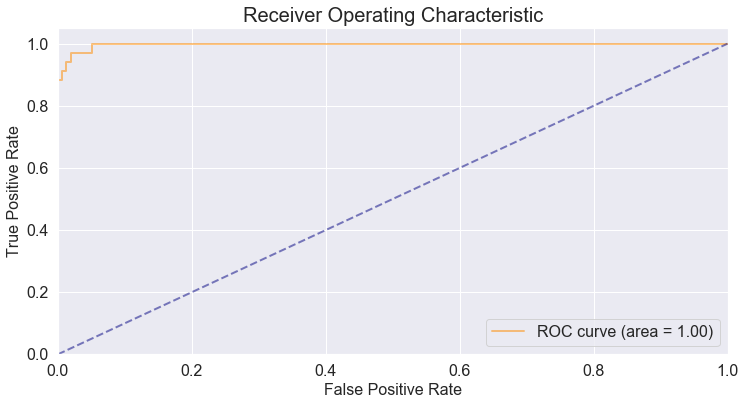

In [54]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
lw = 2

plt.plot(fpr, tpr, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc, alpha=0.5)

plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--', alpha=0.5)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.grid(True)
plt.xlabel('False Positive Rate', fontsize=16)
plt.ylabel('True Positive Rate', fontsize=16)
plt.title('Receiver Operating Characteristic', fontsize=20)
plt.legend(loc="lower right", fontsize=16)
plt.show()

In [55]:
from catboost.utils import get_fpr_curve
from catboost.utils import get_fnr_curve

(thresholds, fpr) = get_fpr_curve(curve=curve)
(thresholds, fnr) = get_fnr_curve(curve=curve)

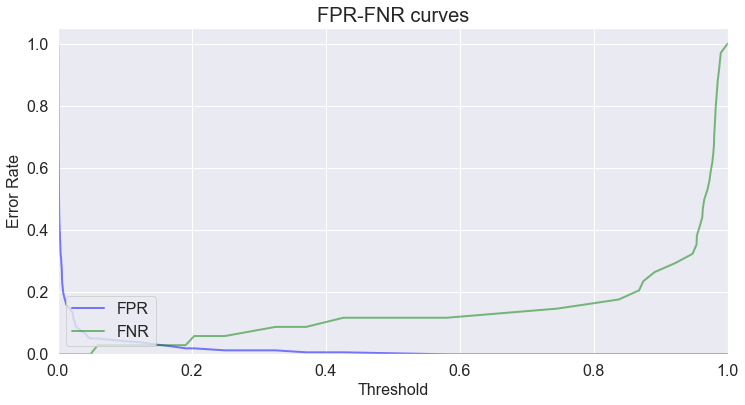

In [56]:
plt.figure(figsize=(12, 6))
lw = 2

plt.plot(thresholds, fpr, color='blue', lw=lw, label='FPR', alpha=0.5)
plt.plot(thresholds, fnr, color='green', lw=lw, label='FNR', alpha=0.5)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.grid(True)
plt.xlabel('Threshold', fontsize=16)
plt.ylabel('Error Rate', fontsize=16)
plt.title('FPR-FNR curves', fontsize=20)
plt.legend(loc="lower left", fontsize=16)
plt.show()

In [57]:
from catboost.utils import select_threshold

print(select_threshold(model=best_model, data=eval_pool, FNR=0.01))
print(select_threshold(model=best_model, data=eval_pool, FPR=0.01))

0.04849102996469465
0.3705453860957082


### 3.13 Shap Values

In [58]:
# Library Catboost menyediakan cara untuk memahami fitur mana yang penting untuk objek tertentu. 
# Mari kita lihat seluruh kumpulan data x dan menganalisis pengaruh berbagai fitur pada objek dari kumpulan data ini. 
# Kami akan menghitung kepentingan untuk setiap objek. Setelah itu akan divisualisasikan

model = CatBoostClassifier(iterations=1000)
model.fit(
    train_pool,
    eval_set=validation_pool,
    verbose=False
    #plot=True
)

shap_info = model.get_feature_importance(train_pool, type = 'ShapValues')
expected_value = shap_info[0,-1]
base_values = shap_info[:,-1]
shap_values = shap_info[:,:-1]
print(shap_values.shape)

(764, 9)


In [59]:
# Melihat prediksi model untuk objek ke-0. 
# Prediksi mentah bukanlah probabilitas, 
# untuk menghitung probabilitas dari prediksi mentah kita perlu menghitung sigmoid (raw_prediction).

test_objects = [x_train.iloc[0:1]]

for obj in test_objects:
    print('Probabilitas kelas 1 = {:.4f}'.format(model.predict_proba(obj)[0][1]))
    print('Formula raw prediction = {:.4f}'.format(model.predict(obj, prediction_type='RawFormulaVal')[0]))
    print('\n')

Probabilitas kelas 1 = 0.0002
Formula raw prediction = -8.7831




In [60]:
# memvisualisasikan penjelasan prediksi pertama
import shap

shap.initjs()
shap.force_plot(expected_value, shap_values[0,:], x_train.iloc[0,:])

Penjelasan di atas menunjukkan fitur yang masing-masing berkontribusi untuk keluaran model dari nilai dasar ke keluaran model. Fitur yang mendorong prediksi lebih tinggi ditampilkan dengan warna merah, sedangkan fitur yang mendorong prediksi lebih rendah ditampilkan dengan warna biru. Kita dapat melihat penjelasan untuk seluruh dataset seperti berikut:

In [61]:
# memvisualisasikan prediksi set pelatihan
shap.force_plot(expected_value, shap_values, x_train)

Untuk memahami bagaimana satu fitur mempengaruhi keluaran model, kita dapat memplot nilai SHAP dari fitur tersebut vs. nilai fitur untuk semua contoh dalam dataset. Karena nilai SHAP mewakili fitur untuk perubahan dalam keluaran model, plot di bawah ini mewakili perubahan prediksi suatu akun fake atau real berdasarkan follower_following_ratio (Perbandingan jumlah follower dengan jumlah following dari setiap akun). Dispersi vertikal pada nilai tunggal follower_following_ratio menunjukkan efek interaksi dengan fitur lain. Untuk lebih jelasnya, `dependence_plot` secara otomatis memilih fitur lain dengan menggunakan pewarnaan. Dalam hal ini pewarnaan oleh RAD, dimana menyoroti bahwa follower_following_ratio memiliki pengaruh yang lebih kecil terhadap prediksi suatu akun untuk daerah dengan nilai RAD yang tinggi.

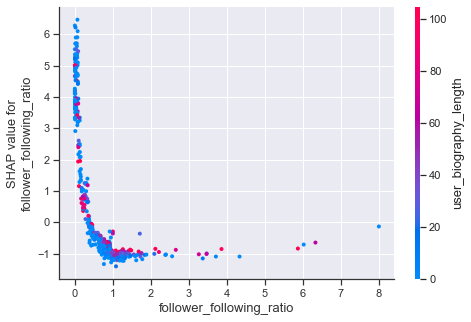

In [62]:
# Membuat plot ketergantungan SHAP untuk menunjukkan efek fitur tunggal di seluruh dataset
shap.dependence_plot("follower_following_ratio", shap_values, x_train)

Jumlah semua nilai shap sama dengan prediksi rumus mentah (raw formula) yang dihasilkan. Dapat dilihat pada grafik di bawah ini bahwa terdapat nilai dasar yang sama untuk semua objek. Dan hampir semua fitur berpengaruh negatif terhadap objek tersebut.

In [64]:
import shap

shap.initjs()
shap.force_plot(base_value=base_values[0], shap_values=shap_values[0], features=x_train.iloc[0])

In [63]:
# fitur terpenting untuk objek ke-3
shap.force_plot(expected_value, shap_values[3,:], x_train.iloc[3,:])

In [66]:
# fitur terpenting untuk objek ke-91
shap.force_plot(expected_value, shap_values[91,:], x_train.iloc[91,:])

Untuk mendapatkan gambaran umum tentang fitur mana yang paling penting untuk model, kita dapat memplot nilai SHAP dari setiap fitur untuk setiap sampel. Plot di bawah mengurutkan fitur berdasarkan jumlah besaran nilai SHAP di semua sampel, dan menggunakan nilai SHAP untuk menunjukkan distribusi dampak yang dimiliki setiap fitur pada keluaran model. Warna mewakili nilai fitur (merah tinggi, biru rendah).

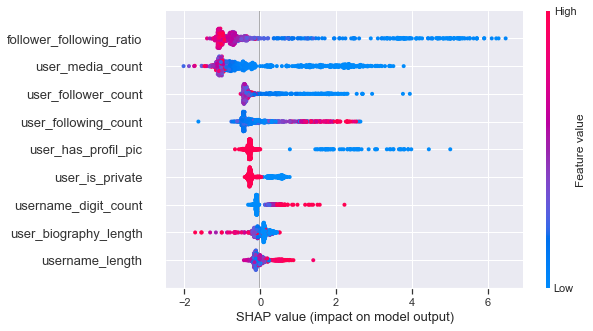

In [67]:
# Melihat informasi gabungan tentang pengaruh pada seluruh dataset.

shap.summary_plot(shap_values, x_train)

Dari grafik di atas kita dapat melihat bahwa nilai fitur follower_following_ratio memiliki pengaruh positif yang besar dan juga memiliki dampak positif terbesar untuk banyak objek.

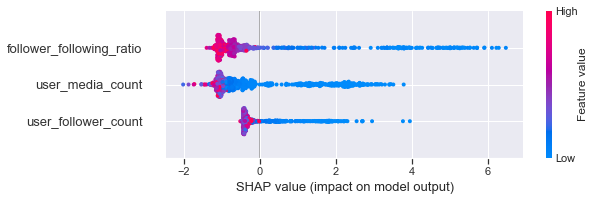

In [69]:
# Hanya memilih tiga fitur paling penting yang ditampilkan di plot.

shap.summary_plot(shap_values, x_train, max_display=3)

In [70]:
# Kita juga dapat menggunakan nilai shap untuk menganalisis pentingnya fitur kategorik

shap_values = model.get_feature_importance(train_pool, type='ShapValues')

expected_value = shap_values[0,-1]
shap_values = shap_values[:,:-1]

Berikut adalah visualisasi pentingnya fitur untuk satu contoh positif dan satu negatif.
Perhatikan bahwa keluaran klasifikasi biner adalah nilai yang tidak berada dalam rentang `[0,1]`. Sehingga kita perlu menghitung nilai fungsi sigmoid untuk menghitung probabilitas akhir.

In [71]:
test_objects = [x_train.iloc[0:1], x_train.iloc[91:92]]

for obj in test_objects:
    print('Probabilitas kelas 1 = {:.4f}'.format(model.predict_proba(obj)[0][1]))
    print('Formula raw prediction = {:.4f}'.format(model.predict(obj, prediction_type='RawFormulaVal')[0]))
    print('\n')

Probabilitas kelas 1 = 0.0002
Formula raw prediction = -8.7831


Probabilitas kelas 1 = 0.9933
Formula raw prediction = 4.9994




Ada beberapa tipe kalkulasi yang bisa diatur menggunakan parameter `shap_calc_type` untuk fungsi `get_feature_importance`. Jenis tersebut adalah `Normal` (default), `Approximate` (bekerja lebih cepat tetapi memberikan hasil yang kurang akurat), `Exact` (bekerja lebih lambat tetapi memungkinkan untuk menghitung hasil yang lebih akurat).

In [76]:
# Evaluasi waktu untuk jenis kalkulasi yang berbeda.
%time approximate = model.get_feature_importance(train_pool, type="ShapValues", shap_calc_type="Approximate")[:, :-1]

Wall time: 52 ms


In [77]:
%time normal = model.get_feature_importance(train_pool, type="ShapValues", shap_calc_type="Regular")[:, :-1]

Wall time: 372 ms


In [78]:
%time exact = model.get_feature_importance(train_pool, type="ShapValues", shap_calc_type="Exact")[:, :-1]

Wall time: 479 ms


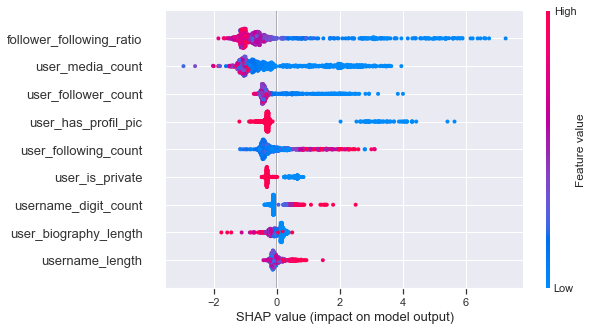

In [79]:
shap.summary_plot(approximate, x_train)

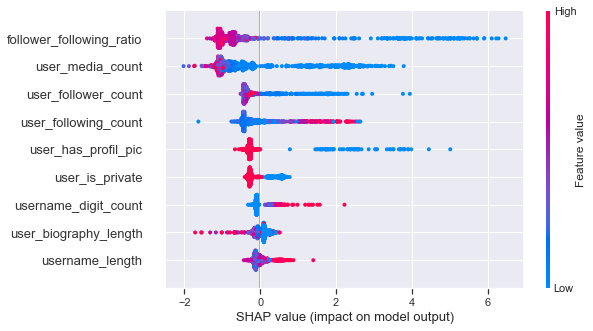

In [80]:
shap.summary_plot(normal, x_train)

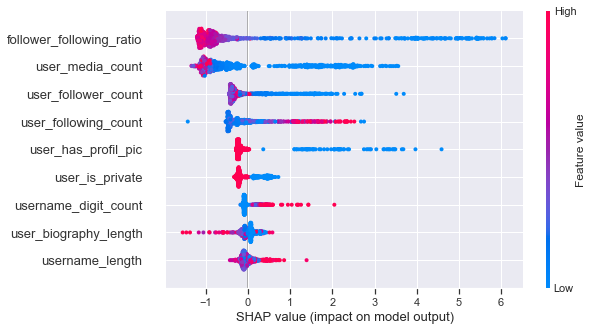

In [81]:
shap.summary_plot(exact, x_train)

### 3.14 Feature Evaluation

Langkah evaluasi fitur:
1. Pilih ukuran folds. Langkah ini bergantung pada tugas yaitu harus menggunakan ukuran fold yang akan menjamin sampel representatif dari populasi umum. Disarankan untuk menggunakan maksimal 50% dari dataset sebagai ukuran fold, karena jika tidak maka akan lebih mudah untuk overfitting.
2. Estimasi parameter learning untuk ukuran fold tersebut. Jika memiliki sampel yang representatif, parameter ini harus konsisten untuk folds yang berbeda. Untuk evaluasi fitur kita tidak perlu menyesuaikan semua parameter, hanya yang utama saja yaitu parameter kecepatan pembelajaran (learning rate) dan ukuran ensemble.
3. Latih model di setiap fold dan hitung metrik test pada dataset lainnya. Untuk dataset yang besar, pengujian fold bisa jadi jauh lebih besar daripada pembelajaran (learn). Dataset semacam itu seharusnya dapat memberikan hasil yang lebih stabil.

Di sini diasumsikan bahwa kita tahu kecepatan pembelajaran (learning rate) optimal dan ukuran ansambel, nanti akan ditunjukkan bagaimana kita dapat dengan mudah memperkirakan parameter ini dan menggunakannya untuk tugas lain seperti perbandingan model.

Kita akan menggunakan fold_size 500 dan learning rate 0,5

In [88]:
from catboost.eval.catboost_evaluation import *
from os.path import join

# CatBoost support custom group_column yang dapat digunakan untuk membagi instance untuk belajar dan juga untuk test folds.
# CatboostEvaluation (group_column = id). Kolom ini dapat berupa jenis apa pun dalam file cd (misalnya, auxilary)

learn_params = {'iterations': 200,     # Maksimal 1000
                'learning_rate': 0.5,  # kita set learning_rate yang besar karena kita memiliki iterasi yang kecil
                'random_seed': 0,
                'verbose': False,
                'loss_function' : 'Logloss',
                'boosting_type': 'Plain',
               # Untuk evaluasi fitur, waktu pembelajaran itu penting dan kita hanya membutuhkan kualitas relatif
                'max_ctr_complexity' : 4}

# Membuat objek evaluator
evaluator = CatboostEvaluation('C:/Users/dell latitude/Documents/SKRIPSI/IG/FakeReal/data_train.tsv',
                               fold_size=500,       # <= 50% data dari total dataset
                               fold_count=20,
                               column_description='C:/Users/dell latitude/Documents/SKRIPSI/IG/FakeReal/train.cd',
                               partition_random_seed=0,
                               # working_dir=...   # Direktori kerja. Karena kita perlu membuat file temp selama evaluasi
                               # jadi pastikan memiliki ruang kosong yang cukup
                               # Secara default kita akan membuat dir temp di direktori temp sistem
                               
                               # group_column = ...# Atur jika memiliki kolom yang akan digunakan untuk split
)

In [69]:
result = evaluator.eval_features(learn_config=learn_params,
                                 eval_metrics=['Logloss', 'Accuracy'],
                                 features_to_eval=[0, 1, 2, 4, 5, 6])  # Cek kualitas dari beberapa fitur

In [70]:
# Sebagai hasilnya, kita memiliki instance dari objek EvaluationResults. 

from catboost.eval.evaluation_result import *

# Untuk mendapatkan hasil untuk satu metrik perlu memanggil metode get_metric_results
logloss_result = result.get_metric_results('Logloss') 

Baseline case adalah pool tanpa semua fitur yang diuji.
Kasus pengujian bergantung pada EvalType.
Untuk mode SeqAdd kita menguji pool dengan setiap fitur ditambahkan ke pool, sementara yang lain masih diabaikan (forward selection):

Jadi jika kita memiliki mode SeqAdd untuk fitur [0, 1, 2], maka test pools adalah:
1. Pool dengan semua fitur kecuali 0, 1
2. Pool dengan semua fitur kecuali 0, 2
3. Pool dengan semua fitur kecuali 1, 2

Dan baseline pool adalah pool tanpa fitur 0, 1, 2

logloss_result adalah turunan dari kelas MetricEvaluationResult dan berisi semua informasi tentang satu metrik. Biasanya kita hanya perlu memanggil 3 metode. Yang pertama adalah get_baseline_comparision untuk membuat tabel dengan hasil evaluasi.

In [71]:
#logloss_result.get_baseline_comparison()   # membuat tabel dengan hasil evaluasi
logloss_result.get_baseline_comparison(
    ScoreConfig(ScoreType.Rel, overfit_iterations_info=True)
)

,PValue,Score,Quantile 0.005,Quantile 0.995,Decision,Overfit iter diff,Overfit iter pValue
Features: 2,0.000089,46.689843,44.499314,48.772142,GOOD,3.10,0.030151
Features: 0,0.000089,45.473692,41.753674,49.299918,GOOD,2.35,0.065399
Features: 6,0.000089,38.265631,36.327145,40.321732,GOOD,3.45,0.006040
Features: 4,0.000089,20.040455,16.140888,23.960034,GOOD,-0.35,0.395752
Features: 1,0.020633,2.531183,0.046838,5.022493,UNKNOWN,1.20,0.052624
Features: 5,0.018675,2.506531,-0.213098,4.968748,UNKNOWN,0.15,0.735352


Dalam tabel untuk setiap kasus pengujian (Pool tanpa beberapa fitur) menunjukkan skor yang dapat dibaca manusia (dapat dikonfigurasi oleh parameter ScoreConfig, secara default kita menggunakan (baseline_score - test_score) * magic_multiplier / baseline_score sebagai skor dalam satu fold. Skor tabel adalah rata-rata skor untuk semua folds. Skor lebih besar berarti kualitas fitur tersebut lebih baik).

Entri tabel terpenting: Decision. Jika ada UNKNOWN atau BAD, maka fitur ini tidak memberikan keuntungan apapun atau tidak memiliki cukup data untuk melihat peningkatan kualitas dari fitur ini.

Jika Decision GOOD, maka fitur memberikan keuntungan.

Namun perlu diketahui, jika overfit iteration besar, maka bisa jadi penjelasan untuk semua keuntungan (profit) yang kita lihat

Metode kedua yaitu create_fold_learning_curve untuk membuat plotly plot pada fold yang dipilih

In [72]:
iplot(logloss_result.create_fold_learning_curves(0))

In [97]:
baseline_case = logloss_result.get_baseline_case()
baseline_case

Features: None

In [98]:
baseline_result = logloss_result.get_case_result(baseline_case)

In [99]:
iplot(baseline_result.create_learning_curves_plot())

#### Memilih learning rate

Sekarang kita akan mencari kecepatan pembelajaran (learning rate). Dalam hal ini kita hanya perlu menyesuaikan model dengan learning rate berbeda, ukuran ansambel tetap dan melihat kurva pembelajaran.

In [111]:
learn_params = {'iterations': 500,     # Maksimal 1000
                'learning_rate': 0.1,  # kita set learning_rate yang besar karena kita memiliki iterasi yang kecil
                'random_seed': 0,
                'verbose': False,
                'loss_function' : 'Logloss',
                #'boosting_type': 'Plain',
                'max_ctr_complexity' : 1}

In [112]:
learning_rate_params = learn_params

baseline_case = ExecutionCase(label="Step {}".format(0.03),
                              params=learning_rate_params, 
                              learning_rate=0.03)

other_learning_rate_cases = [ExecutionCase(label="Step {}".format(step), 
                                           params=learning_rate_params, 
                                           learning_rate=step) for step in [0.5, 0.1, 0.05, 0.015]]

evaluator = CatboostEvaluation('C:/Users/dell latitude/Documents/SKRIPSI/IG/FakeReal/data_train.tsv',
                               fold_size=500,    # <= 50% data dari total dataset
                               fold_count=1,     # Untuk estimasi learning rate kita hanya membutuhkan 1 fold
                               column_description='C:/Users/dell latitude/Documents/SKRIPSI/IG/FakeReal/train.cd',
                               partition_random_seed=0,
)


In [113]:
evaluator.get_working_dir()

'C:\\Users\\DELLLA~1\\AppData\\Local\\Temp\\tmpeot7k8bj'

In [114]:
learning_rates_result = evaluator.eval_cases(baseline_case, 
                                             other_learning_rate_cases,
                                             eval_metrics="Logloss")

# Hasilnya

logloss_learning_rate_search_results = learning_rates_result.get_metric_results("Logloss")

# Melihat kurva

tmp = logloss_learning_rate_search_results.create_fold_learning_curves(fold=0, offset=50)
iplot(tmp)

Jadi kita dapat melihat bahwa learning rate 0.03 cukup baik.

### 3.15 Stdout of The Training

In [131]:
# Kita dapat melihat nilai stdout dari fungsi loss pada setiap iterasi, atau pada setiap iterasi ke-k.
# Selain itu, juga dapat melihat berapa lama waktu sejak dimulainya pelatihan dan berapa banyak waktu yang tersisa.

model = CatBoostClassifier(
    iterations=15,
    #verbose=5 # Hanya menampilkan iterasi setiap pengulangan 5 saja
)

model.fit(
    train_pool,
    eval_set=validation_pool,
)

Learning rate set to 0.184261
0:	learn: 0.5684564	test: 0.5651442	best: 0.5651442 (0)	total: 7.33ms	remaining: 103ms
1:	learn: 0.4746725	test: 0.4751286	best: 0.4751286 (1)	total: 13.3ms	remaining: 86.7ms
2:	learn: 0.4064589	test: 0.4068190	best: 0.4068190 (2)	total: 20ms	remaining: 79.8ms
3:	learn: 0.3495758	test: 0.3479930	best: 0.3479930 (3)	total: 26.2ms	remaining: 72.2ms
4:	learn: 0.3069390	test: 0.3037426	best: 0.3037426 (4)	total: 33.2ms	remaining: 66.4ms
5:	learn: 0.2703812	test: 0.2670306	best: 0.2670306 (5)	total: 39.1ms	remaining: 58.7ms
6:	learn: 0.2396801	test: 0.2363362	best: 0.2363362 (6)	total: 46.9ms	remaining: 53.6ms
7:	learn: 0.2151227	test: 0.2121784	best: 0.2121784 (7)	total: 53.7ms	remaining: 47ms
8:	learn: 0.1959845	test: 0.1940442	best: 0.1940442 (8)	total: 61.5ms	remaining: 41ms
9:	learn: 0.1810336	test: 0.1776657	best: 0.1776657 (9)	total: 67.4ms	remaining: 33.7ms
10:	learn: 0.1650909	test: 0.1643472	best: 0.1643472 (10)	total: 74.2ms	remaining: 27ms
11:	learn

In [122]:
# Jika tidak menentukan random_seed maka benih acak (random seed) akan disetel ke nilai baru setiap saat.
# Setelah pelatihan selesai kita dapat melihat nilai dari random seed yang telah ditetapkan.
# Jika kita latih lagi dengan random_seed, maka tetap akan mendapatkan hasil yang sama.

random_seed = model.random_seed_
print('Used random seed = ' + str(random_seed))
model = CatBoostClassifier(
    iterations=15,
    random_seed=random_seed
)
model.fit(
    train_pool,
    eval_set=validation_pool,
)

Used random seed = 0
Learning rate set to 0.184261
0:	learn: 0.5684564	test: 0.5651442	best: 0.5651442 (0)	total: 7.71ms	remaining: 108ms
1:	learn: 0.4746725	test: 0.4751286	best: 0.4751286 (1)	total: 14.5ms	remaining: 94.2ms
2:	learn: 0.4064589	test: 0.4068190	best: 0.4068190 (2)	total: 20.5ms	remaining: 82.1ms
3:	learn: 0.3495758	test: 0.3479930	best: 0.3479930 (3)	total: 26.9ms	remaining: 74.1ms
4:	learn: 0.3069390	test: 0.3037426	best: 0.3037426 (4)	total: 33.3ms	remaining: 66.6ms
5:	learn: 0.2703812	test: 0.2670306	best: 0.2670306 (5)	total: 39.4ms	remaining: 59.1ms
6:	learn: 0.2396801	test: 0.2363362	best: 0.2363362 (6)	total: 46.1ms	remaining: 52.7ms
7:	learn: 0.2151227	test: 0.2121784	best: 0.2121784 (7)	total: 52.2ms	remaining: 45.7ms
8:	learn: 0.1959845	test: 0.1940442	best: 0.1940442 (8)	total: 59ms	remaining: 39.3ms
9:	learn: 0.1810336	test: 0.1776657	best: 0.1776657 (9)	total: 65ms	remaining: 32.5ms
10:	learn: 0.1650909	test: 0.1643472	best: 0.1643472 (10)	total: 71.8ms	re

### 3.16 Tree Visualization

In [126]:
# Membuat model CatBoost dengan pohon kedalaman 2.

model = CatBoostClassifier(depth=2, verbose=False, iterations=10).fit(x_train, y_train)

Sampai saat ini hanya pohon simetris yang dapat divisualisasikan.

Dalam pohon simetris, hanya satu fitur yang digunakan untuk membangun semua split di setiap tingkat pohon. Ada tiga jenis split: "FloatFeature", "OneHotFeature", dan "OnlineCtr". Model tanpa fitur kategoris hanya terdiri dari split "FloatFeature".

Dalam pohon yang divisualisasikan, setiap node mewakili satu split. Karena ada tiga jenis split, maka ada tiga jenis simpul pohon.

Parameter "pool" adalah opsional untuk model tanpa fitur kategorik. Fitur diberi label dengan indeks eksternalnya dari fitur nama atau pool jika pool disediakan, jika tidak, indeks internal digunakan.

##### OneHotFeature

Dengan menggunakan dataset yang berisi data kategorik.

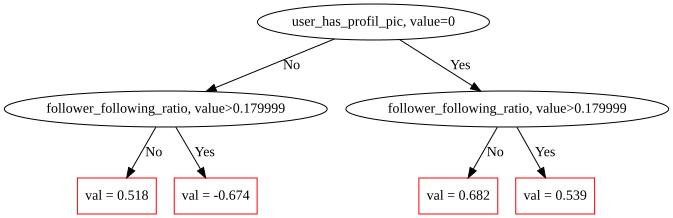

In [16]:
import graphviz

os.environ["PATH"] += os.pathsep + 'C:/Users/dell latitude/anaconda3/Library/bin/graphviz/'

model = CatBoostClassifier(
    max_depth=2, verbose=False, max_ctr_complexity=1, random_seed=42, iterations=2).fit(train_pool)

model.plot_tree(
    tree_idx=1,
    pool=train_pool     # "pool" adalah parameter wajib untuk pohon dengan minimal satu fitur kategorik
)

Pohon pertama hanya berisi satu split yang dibuat oleh fitur kategorik user_has_profil_pic. Split ini menempatkan objek yang tidak memiliki foto profil (No) ke kiri dan objek yang memilki foto profil (Yes) ke kanan.

### 3.17 Model Saving 

Sangat berguna untuk dapat menyimpan model ke dalam disk (terutama jika pelatihan membutuhkan waktu).

Selain dapat menyimpan model sebagai kode Python atau C ++, kita juga dapat menyimpan model sebagai file biner

Jika menyimpan model sebagai file biner, maka kita dapat melihat parameter yang digunakan untuk melatih model, termasuk learning_rate dan random_seed yang disetel secara otomatis jika tidak ditentukan.

In [17]:
model = CatBoostClassifier(iterations=200, random_seed=42, logging_level='Silent').fit(train_pool)
model.save_model('catboost_model.dump')
model = CatBoostClassifier()
model.load_model('catboost_model.dump');

In [104]:
my_best_model = CatBoostClassifier(iterations=10)
my_best_model.fit(
    x_train, y_train,
    eval_set=(x_validation, y_validation),
    cat_features=cat_features,
    verbose=False
)
my_best_model.save_model('catboost_model.bin')

In [105]:
my_best_model.load_model('catboost_model.bin')
print(my_best_model.get_params())
print(my_best_model.random_seed_)
print(my_best_model.learning_rate_)

{'iterations': 10, 'loss_function': 'Logloss', 'verbose': 0}
0
0.2198030055


##### CatBoost JSON model

CatBoost juga mendukung ekspor model ke format JSON dan memuat model darinya.

In [106]:
# Save model JSON ke file

my_best_model.save_model(
    'catboost_model.json', 
    format='json'
    # pool = pool  # parameter ini diperlukan hanya untuk model dengan fitur kategoris.
)

In [107]:
# Memuat model dari file sebagai JSON dan menunjukkan keys. Model json berisi model_info, oblivious_trees dan features_info. 
# Model dengan fitur kategoris juga akan berisi ctrs

model = json.load(open('catboost_model.json', 'r'))
model.keys()

dict_keys(['features_info', 'model_info', 'oblivious_trees', 'scale_and_bias'])

In [108]:
# model['model_info'] adalah analog untuk fungsi get_metadata ().
# Kita dapat melihat parameter pelatihan yang digunakan untuk melatih model 
# atau versi catboost yang digunakan model tersebut.

print(model['model_info']['catboost_version_info'])

Git info:
    Commit: e94bcd3987d868ce0832af0a6aa61dc1b123ed45
    Branch: heads/master
    Author: somov <somov@yandex-team.ru>
    Summary: Fix clang-cl build: contrib/libs/lzmasdk
    git-svn info:
    Last Changed Rev: 7251233

Other info:
    Build by: PLATFORM-W10$
    Top src dir: C:\Program Files (x86)\Go Agent\pipelines\BuildMaster\catboost.git
    Top build dir: C:\Users\zomb-ml-platform-msk\.ya\build
    Hostname: platform-w10
    Host information: 
        Microsoft Windows [Version 10.0.17134.1667]

    


In [109]:
# Melihat nilai features_info
# Ini bisa berisi 𝑓𝑙𝑜𝑎𝑡_𝑓𝑒𝑎𝑡𝑢𝑟𝑒𝑠, 𝑐𝑎𝑡𝑒𝑔𝑜𝑟𝑖𝑐𝑎𝑙_𝑓𝑒𝑎𝑡𝑢𝑟𝑒𝑠 dan 𝑐𝑡𝑟𝑠, yang merupakan daftar deskripsi dari beberapa fitur.

model['features_info'].keys()

dict_keys(['categorical_features', 'float_features'])

CatBoost menggunakan pohon simetris atau pohon oblivious. Untuk setiap tingkat pohon CatBoost menggunakan fitur yang sama untuk membagi contoh pembelajaran ke partisi kiri dan kanan: pada pohon tingkat pertama dipartisi dengan pemisahan pertama menjadi dua bagian, pada tingkat kedua setiap subpohon dibagi dengan pemisahan kedua dan seterusnya.

Dalam hal ini pohon dengan kedalaman 𝑘 memiliki tepat $2^𝑘$ daun dan $𝑘$ split, masing-masing terpisah pada lapisan berikutnya.

Ada tiga jenis pemisahan (split): "FloatFeature", "OneHotFeature", dan "OnlineCtr". Model tanpa fitur kategoris hanya berisi split "FloatFeature".

Kita lihat bagaimana model JSON mendeskripsikan satu pohon. Pohon dengan kedalaman $𝑘$ dideskripsikan dengan $2^𝑘$ leaf_values, $2^k$ leaf_ weights dan $𝑘$ splits

In [115]:
def dump_json(item):
    print(json.dumps(item, indent=2))

dump_json(model['oblivious_trees'][0])  # Pohon pertama dari model

{
  "leaf_values": [
    0.05495075136423111,
    -0.4042014999677671,
    0,
    -0.33410056829452517,
    0.057339914467023766,
    -0.2930706739425659,
    0,
    -0.26943594217300415,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0.12929588556289673,
    0.048845112323760986,
    0,
    0,
    0.09769022464752197,
    0.1156857923457497,
    0,
    0,
    0.03381584699337299,
    0.03381584699337299,
    0,
    0,
    0,
    0,
    0,
    0,
    0.21980300545692444,
    -0.4013794012691663,
    0,
    -0.4053509970764061,
    0.21166215340296426,
    -0.3361693024635315,
    0.03381584699337299,
    -0.3486530431385698,
    0.03381584699337299,
    0.03381584699337299,
    0,
    0,
    0.03381584699337299,
    0,
    0,
    -0.03381584699337299,
    0.22859512567520143,
    0.06280085870197841,
    0,
    -0.06280085870197841,
    0.23445653915405273,
    0,
    0,
    0,
    0,
    0,
    0,
    0,
    0.10990150272846222,
    0.03381584699337299,
    0,
    0
  ],


- Daftar "leaf_values" menjelaskan nilai dalam daun. Ini adalah pohon dengan 4 daun, memiliki kedalaman 2, yang berarti memiliki dua split yang berbeda. Split pertama digunakan untuk membagi semua objek menjadi kiri dan kanan. Dan split kedua digunakan dua kali, untuk membagi objek kiri menjadi dua bagian, dan untuk membagi objek kanan menjadi dua bagian. Indeks dalam daftar dapat direpresentasikan menggunakan sistem angka basis-2 dengan cara berikut: 00, 01, 10, 11. Daun 00 adalah daun di mana split ke-0 dan split ke-1 sama dengan False. Daun 01 berisi objek di mana split ke-0 sama dengan False dan split ke-1 sama dengan True. Dan seterusnya.

- Bagian selanjutnya dari deskripsi pohon disebut "leaf_weights". Daftar ini mewakili jumlah bobot sampel pelatihan, yang ada di daun ini. Indeksasi daun dalam daftar ini sama dengan di "leaf_values".

- Bagian terakhir adalah "split", dan itu adalah deskripsi dari dua split yang digunakan pada pohon kedalaman dua. Setiap deskripsi berisi beberapa keys-values. Pertama, ini berisi parameter CatBoost internal $split\_index$. Ini adalah satu-satunya parameter yang digunakan oleh catboost saat memuat model, semua bagian lain dalam "splits" diabaikan (mereka digandakan di tempat yang berbeda), dan yang ada di sini hanya untuk membuat model lebih mudah dipahami.

##### Truncate model

Model dapat dimodifikasi dan diterapkan. Potong (truncate) dan terapkan model

In [120]:
trees = model['oblivious_trees'][:]

In [122]:
cls = catboost.CatBoostClassifier(depth=2, random_seed=0, iterations=10, verbose=False)
cls.fit(train_pool) 
approx = cls.predict(x_train[0:3], prediction_type="RawFormulaVal")
approx

array([-4.4513, -4.3557, -3.9796])

In [124]:
model['oblivious_trees'] = trees[0:5]                 # hanya gunakan 5 pohon pertama
json.dump(model, open("head_model.json", "w"))        # Save modified model
cls.load_model("head_model.json", "json")             # load model
cls.predict(x_train[0:3], prediction_type="RawFormulaVal")  # apply model

array([-1.5083, -1.5191, -1.5649])

In [125]:
model['oblivious_trees'] = trees[5:]                  # drop 5 pohon pertama
json.dump(model, open("tail_model.json", "w"))        # Save modified model
cls.load_model("tail_model.json", "json")             # load model
cls.predict(x_train[0:3], prediction_type="RawFormulaVal")  # apply model

array([-1.0601, -1.0424, -1.0745])

## $$4.\ Parameters\ Tuning$$
Meskipun kita selalu dapat memilih jumlah optimal dari iterasi dengan cross validation dan plot kurva pembelajaran, penting juga untuk bermain dengan beberapa parameter model. 

Di bagian ini, kita akan memilih parameter `l2_leaf_reg` dan `learning_rate` dengan menggunakan package **`hyperopt`**.

In [39]:
!pip install hyperopt

In [133]:
import hyperopt

def hyperopt_objective(params):
    model = CatBoostClassifier(
        l2_leaf_reg=int(params['l2_leaf_reg']),
        learning_rate=params['learning_rate'],
        iterations=500,
        eval_metric='Accuracy',
        random_seed=42,
        verbose=False,
        loss_function='Logloss',
    )
    
    cv_data = cv(
        Pool(x_train, y_train, cat_features=cat_features),
        model.get_params()
    )
    best_accuracy = np.max(cv_data['test-Accuracy-mean'])
    
    return 1 - best_accuracy        # hyperopt minimises

In [134]:
from numpy.random import RandomState

params_space = {
    'l2_leaf_reg': hyperopt.hp.qloguniform('l2_leaf_reg', 0, 2, 1),
    'learning_rate': hyperopt.hp.uniform('learning_rate', 1e-3, 5e-1),
}

trials = hyperopt.Trials()

best = hyperopt.fmin(
    hyperopt_objective,
    space=params_space,
    algo=hyperopt.tpe.suggest,
    max_evals=50,
    trials=trials,
    rstate=RandomState(123)
)

print(best)

100%|██████████| 50/50 [54:34<00:00, 65.48s/trial, best loss: 0.027477034120734878]
{'l2_leaf_reg': 4.0, 'learning_rate': 0.46181411601283945}


Setelah melakukan parameter tuning dengan menggunakan package hyperopt diperoleh parameter `l2_leaf_reg` terbaik yaitu 4.0 dan parameter `learning_rate` terbaik yaitu 0.46181411601283945

#### Hyperparameters Tuning

Kita juga dapat menyetel parameter untuk mendapatkan kecepatan yang lebih baik atau kualitas yang lebih baik. Berikut adalah daftar parameter yang penting untuk kecepatan dan akurasi.

#### 1) Training speed

Berikut adalah daftar parameter yang penting untuk mempercepat pelatihan. Selain itu perlu diperhatikan bahwa mengubah parameter ini juga dapat menurunkan kualitas.

1. Jumlah iterasi dan kecepatan pembelajaran (learning rate). Secara default jumlah iterasi adalah 1000 iterasi. Kita tentu saja dapat menurunkan angka tersebut, tetapi jika menurunkan jumlah iterasi maka kita perlu meningkatkan learning rate agar prosesnya konvergen. Secara default learning rate ditentukan dengan bergantung pada jumlah iterasi dan dataset yang dimiliki, jadi jika kita menggunakan learning rate default saja itu sudah baik. Tetapi jika kita ingin menentukannya sendiri, maka perlu dicatat bahwa semakin banyak iterasi yang dimiliki, maka semakin kecil kecepatan pembelajarannya.

2. boosting_type secara default adalah menggunakan Ordered Boosting untuk dataset yang lebih kecil dengan tujuan menghindari overfitting. Tetapi hal tersebut boros dalam komputasi, sehingga kita dapat menyetel boosting_type ke Plain untuk menonaktifkannya.

3. bootstrap_type secara default mengambil sampel bobot dari distribusi eksponensial. Lebih cepat menggunakan sampling dari distribusi Bernoulli. Untuk mengaktifkannya gunakan bootstrap_type = 'Bernoulli' + subsample = {some value <1}

4. one_hot_max_size secara default menggunakan one-hot encoding hanya untuk fitur kategorik dengan sedikit nilai yang berbeda. Untuk fitur kategorik lainnya dihitung secara statistik. Hal tersebut boros, sehingga kita dapat mempercepat pelatihan dengan mengatur one_hot_max_size ke nilai yang lebih besar

5. rsm, parameter ini sangat penting karena mempercepat pelatihan dan tidak mempengaruhi kualitas. Jadi kita pasti harus menggunakannya, tetapi hanya jika memiliki ratusan fitur. Jika memiliki sedikit fitur, lebih baik tidak menggunakan parameter ini. Jika kita memiliki banyak fitur maka aturannya adalah menurunkan rsm. Misalnya, kita menetapkan rsm = 0,1. Dengan nilai rsm ini, pelatihan membutuhkan lebih banyak iterasi agar konvergen. Biasanya kita membutuhkan sekitar 20% lebih banyak iterasi. Tetapi setiap iterasi akan 10x lebih cepat. Jadi waktu pelatihan yang dihasilkan akan lebih cepat meskipun kita akan memiliki lebih banyak pohon dalam model yang dihasilkan.

6. leaf_estimation_iterations, parameter ini bertanggung jawab untuk menghitung nilai daun setelah memilih struktur pohon. Nilai default untuk parameter ini bergantung pada tujuan pelatihan, kita dapat mencoba menyetelnya ke 1 atau 5, dan jika kita memiliki sedikit fitur, hal tersebut mungkin dapat mempercepat pelatihan.

7. max_ctr_complexity, secara default catboost menghasilkan kombinasi fitur kategorikal dengan cara greedy. Hal tersebut memakan waktu, sehingga kita dapat menonaktifkannya dengan menyetel max_ctr_complexity = 1 atau dengan mengizinkan hanya kombinasi dari 2 fitur dengan menyetel max_ctr_complexity = 2. Ini akan mempercepat pelatihan hanya jika kita memiliki fitur kategorik.

8. Jika melatih model pada GPU, kita dapat mencoba mengurangi border_count. Ini adalah jumlah pemisahan yang dipertimbangkan untuk setiap fitur. Secara default border_count disetel ke 128, tetapi kita dapat mencoba menyetelnya ke 32. Dalam banyak kasus, hal tersebut tidak akan menurunkan kualitas model dan akan mempercepat pelatihan.

In [7]:
fast_model = CatBoostClassifier(
    random_seed=63,
    iterations=500,
    learning_rate=0.46181411601283945,
    boosting_type='Plain',
    bootstrap_type='Bernoulli',
    subsample=0.5,
    one_hot_max_size=20,
    rsm=0.5,
    leaf_estimation_iterations=5,
    max_ctr_complexity=1)

fast_model.fit(
    x_train, y_train,
    cat_features=cat_features,
    verbose=False,
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

#### 2) Accuracy

Parameter yang tercantum di bawah ini penting untuk mendapatkan kualitas model terbaik. Kita coba ubah parameter tersebut untuk meningkatkan kualitas model yang dihasilkan.

In [116]:
tunned_model = CatBoostClassifier(
    random_seed=63,
    iterations=1000,
    learning_rate=0.46181411601283945,
    l2_leaf_reg=4.0,
    bagging_temperature=1,
    random_strength=1,
    one_hot_max_size=2,
    leaf_estimation_method='Newton'
)
tunned_model.fit(
    x_train, y_train,
    cat_features=cat_features,
    verbose=False,
    eval_set=(x_validation, y_validation),
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

#### Training model setelah parameter tunning

In [117]:
best_model = CatBoostClassifier(
    random_seed=63,
    iterations=int(tunned_model.tree_count_ * 1.2),
)
best_model.fit(
    x_train, y_train,
    cat_features=cat_features,
    verbose=50
)

Learning rate set to 0.407227
0:	learn: 0.4429412	total: 2.22ms	remaining: 33.3ms
15:	learn: 0.0634945	total: 24.8ms	remaining: 0us
